# NLP For Classification - The Language of Job Postings
## Technical Report

## Problem Statement:

**Objective**

Searching for new jobs can be an arduous process. The diligent can get through 10-20 per week, and the hit rate may not be that high. If the job search goes for 2 months, thats around 150 job postings. From my initial search, there are 1000s of data science/ data analyst positions, and many more similar positions under business and product engineers. So can data science help data scientists find jobs?

Assumption: NLP can be used with the detailed job descriptions to 
1. predict job titles (if any) for job descriptions
2. in process of predicting job titles, which titles are similiar and why?
3. word patterns for various jobs
4. what can we learn about the machine learning industry from these job postings?

<a id='home'></a>
## Table of Contents

<a id='home'></a>
- ** A. Preface: Terminology** <a href='#sectionA'>link</a> 
- ** 0. Data sources / Scraping** <a href='#section0'>link</a> 
- ** 1. Loading Libraries** <a href='#section1'>link</a>
- ** 2. Loading Data** <a href='#section2'>link</a>
- ** 3. Data Munging (Post scrape)** <a href='#section3'>link</a>
- ** 4. EDA** <a href='#section3'>link</a>
- ** 5. Feature Engineering - "Line Items" and "Hard Skills"** <a href='#section4'>link</a>
- ** 6. NLP Tokenizing** <a href='#section6'>link</a>
- ** 7. Split X and Y** <a href='#section7'>link</a>
- ** 8. One vs. Rest Classification : Logistic Regression** <a href='#section8'>link</a>
- ** 9. Logistic Classification Sample** <a href='#section9'>link</a>
- ** 10. Post Model Sample - Top Word Features per Expanded Title**  <a href='#section10'>link</a>
- ** 11. Post Model Sample - Top Classifications by Probability**  <a href='#section11'>link</a>
- ** 12. Post Model Sample - Top Word Count per Posting**  <a href='#section12'>link</a>
- ** 13. Assembling all Post Model Results**  <a href='#section13'>link</a>
- ** 14. Plotting Multi Class Roc Curves**  <a href='#section14'>link</a>
- ** 15. Comparing Different Models**  <a href='#section15'>link</a>
- ** 16. Optimized Regularized Model**  <a href='#section16'>link</a>
- ** 17. Comparison of Betas of Regularized and Non Models**  <a href='#section17'>link</a>
- ** Appendix AWS python code** <a href='#appendix'>link</a>

## A. Preface : Vocabulary

**NLP** - Natural Language processing - the study of words using large scale computational resources

**EDA** - Exploratory Data Analysis - high level survey of available data before doing any statistical predictions

**Scraping** - specifically webscraping is the process of extracting information from websites using programming tools to be consolidated into a central and normalized data repository

**Munging** - Cleaning the data, filling in blanks, changing formats, getting rid of excess characters, calculating intermediate values such as average / mode/ max values.

**Base Title** - this is the lowerest level of a job title; "product quality engineer" would be reduced down to "engineer" and "senior data scientist of chemical diffusion" would be "scientist".

**Expanded Title** - this is the 2nd lowerest level of a job title; "senior software engineer of VR" would be reduced down to "software engineer" and "senior data scientist of chemical diffusion" would be "data scientist".

**LDA** - Latent Dirchilet Allocation: https://en.wikipedia.org/wiki/Latent_Dirichlet_allocation is a generative statistical model that allows sets of observations to be explained by unobserved groups that explain why some parts of the data are similar. This is a text analysis technique to extract "common topics"

**Multi Classification** - Normally classification is binary, like 1 for yes, and 0 for no. But often times there can be multiple discrete classifications, such as "car", "van", "truck", and for these classifications, these are referred to as Multi-class problems

**AWS** - stands for Amazon Web Services, provides on-demand computing. In this project a linux-based AWS instance was used for some of the heavy processing required.

**Betas** - these refer to final coefficients for the trained model after multiple statistical calculations and iterations

**Features** - features are variables that will be used as a basis to predict an output. For instance, to predict a total credit card bill, features or inputs might be (total purchases), (number of electronics), (number of times eating out). Can be considered synonymously with 'inputs'

**Regularization** - This approach/method adds an artificial mathematical penalty term to the mathematical calculations. This technique is used on complex modles and relates/addresses to the number of variables (or features), and their relationship with each other. 


## 0. Data Sources and Webscraping

### Goals : Pull job postings for possible data science-related careers, using the following search terms and parameters


**Terms Searched for:**
- "Data Science"
- "Data Scientist"
- "Data Analyst"
- "Data Engineer"
- "Business Analyst"
- "Machine Learning"
- "Statistics"
- "Product Analyst"
- "Deep Learning"

**Cities/Locations**
- San Francisco, CA
- Mountain View, CA
- Seattle, WA
- Los Angeles, CA
- Boston, MA
- New York, NY
- Philadelphia, PN
- Washington, DC
- Atlanta, GA
- Houston, TX
- Austin, TX
- Chicago, IL
- Minneapolis, MN

**Job Website 1:** the website has an API. Python was used to pull job listing urls, but just has titles, company names, cities, and states. Python, requests library was used to pull from the API. From those links, python with selenium was used to pull job description details. 50,000 job postings were pulled **Notes:** Noted in the EDA, but a majority of the job postings were duplicates, after de-duping, the total unique postings were around 14,000. 

**Process**
1. Get API key by registering
2. Write python looper for ~14 different cities, using same API search string (no max for search results)
3. For each search string, pull all possible results using python to go through the pagination
4. Save all the individual job links (~50,000)
5. Start 2nd crawler to pull jobdescription details for the remaining jobs


**Job Website 2:** the website does not have an API, so for both the job links and the job descriptions, selenium was used over a period of 2 weeks at a slow 20sec delay to pull 14,000 job postings. Due to website security and blocking, scraping was very slow, and had to be restarted multiple times. Search results were capped at 40 pages x 25 results per page = 1000 search results. As a result a list of ~ 14 cities x ~10 search terms were used to make ~140 unique searches.

**Process**
1. Test website limitis
2. Write python looper for 140 different search combinations
3. For each search string, pull all possible results using selenium to go through the pagination
4. Save all the individual job links (~14,000)
5. Start 2nd crawler to pull jobdescription details for the remaining jobs

#### HTML --> Beautiful Soup / Xpath ---> Data in dictionaries -- > Data Frames

*Beautiful Soup* and *XPath* were used to parse through all 50,000 job listings. Luckily most of the job postings were somewhat in the same format, though did have some differences. Some jobs didn't post the city location, only the state, some jobs didn't list the location of the company. Between the two different job website sources, two different templates had to be developed for iterating and pulling data. Here are some highlights:

- Transform < br > into new lines
- change bullet point or numbered Lists like this one into new line delimited lists
- Convert from HTML -- > text(unicode) --> decode by UTF-8 into something that pandas can use. For example. HTML uses %20c as ' ' space. So there's 2 layers of translation going on
- Web authors love < span > and < div > a little to much, at the most, sometime there was a div per paragraph and div per sub list within the paragraph and another one for formatting. Required some tricks to condense all the text to the same hierarchy level

#### Condensing Titles --- > Base Titles, and Expanded Titles

Common jobs have a myriad of prefixes such as "senior sales data analyst", "data analyst of marketing", "medical data analyst", which at their root condense down to "analyst" at the most general, and "data analyst" at next level of specificity.



<a id='section1'></a>
## 1. Loading python libraries

All the standard python sklearn libraries are used. 

Plotting selection: Altair https://github.com/minrk/altair/blob/master/README.md
Used this graphing package over the matplotlib and seaborn because of the categorical nature of most of data. Most of the main features are word based and altair makes it a lot easier to accept word/categorical inputs

In [43]:
#load the data libraries needed
import datetime
import pandas as pd
import cPickle as pickle
import patsy
import unidecode
import numpy as np
from altair import Chart, SortField, X as X_axis, Y as Y_axis, Axis

from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.multiclass import OneVsRestClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.linear_model import LogisticRegression, SGDClassifier, LogisticRegressionCV
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import roc_curve, roc_auc_score, auc, confusion_matrix
from scipy import interp

<a id='section2'></a> <a href='#home'>Back to Table of Contents</a>
## 2. Loading / Source Data

We will be loading a data frame that was combined from several webscraping processes. Two major job websites were scraped and the common fields were combined together via Scrapy, Pandas, XPath, and Selenium. The 22k records scraped took roughly 2 weeks to pull from the various websites. A long de-duping process was also required afterwards. Pickle was used to save the data frame and restore to This same dataset was used as baseline for a number of other studies:

- Linear Regression on applicant views
- Topic Modeling
- Recommender Systems
- Current analysis

In [44]:
# Loading Data from Pickle
# the dataframe was created by the webscraping process I have built for a few websites
# the HTML has been pre-parsed and cleaned up

with open('../jNotebooks/master_total_df.p','rb') as f:
    master_total_df = pickle.load(f)

master_total_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22707 entries, 0 to 22706
Data columns (total 16 columns):
index              22707 non-null int64
company            22706 non-null object
jobdesc            22707 non-null object
city               22697 non-null object
state              22204 non-null object
title              22707 non-null object
sourcesite         22707 non-null object
views              22707 non-null int64
days_posted        8038 non-null object
post_start_date    8038 non-null object
link               22707 non-null object
base_title         22707 non-null object
parsed_title       22707 non-null object
parsed_title_i     22707 non-null object
expanded_title     21261 non-null object
prefix_title       21261 non-null object
dtypes: int64(2), object(14)
memory usage: 2.8+ MB


In [45]:
#Sample of full job Titles from all the job postings collected

print master_total_df.title[:25].values

['Clinical Practice Specialist - 4 Hope' 'WEB DEVELOPER'
 'Analyst, Marketing Analytics' 'Data Engineer'
 'Application Implementation Specialist' 'Consulting Analyst'
 'Data Integration Engineer' 'Health Care Junior Business Analyst'
 'Solutions Architect' 'Senior Application Developer' 'Data Analyst Junior'
 'Clinical Informatics Data Analyst' 'Junior Data Scientist, Marketing'
 'Business Intelligence Analyst' 'SEO Specialist'
 'Market and Cost Intelligence Analyst' 'Data Analyst'
 'Application Developer/Analyst' 'Senior Data Analyst, Discovery Analytics'
 'Big Data Senior Consultant - Information Delivery'
 'Business Intelligence Engineer - Amazon Restaurants'
 'Principle Software Engineer'
 'Healthcare & Finance Analyst, Performance Measurement'
 'Application Development Programmer Specialist'
 'Senior Analyst, Strategy & Operations']


<a id='section3'></a> <a href='#home'>Back to Table of Contents</a>
## 3. Cleaning and Munging Data

Since the majority of our analysis is text based, HTML <--> unicode <--> UTF-8 conversion is required, so the below uncode function was created to change some of the scraped text into unicode to decode to a workable standard string format. This function was used repeated lead prepping for Word Tokenizing or for Topic analysis, or repairing the text.

Some common issues when working with HTML:
- Some python features require unicode, others do not
- < br > must be converted into new lines
- some HTML pages have UL and LI list item tags that need to be converted to new lines
- Many people used implicit formatting (many new lines) to make a text-friendly posting
- HTML has its own type of "coding" for instance  %20 == space http://www.w3schools.com/tags/ref_urlencode.asp
- Some job postings have ZERO formatting, its a solid paragraph of text.

#### Sample Posting, with normal formatting

>The Software Engineer III is responsible for the development of large-scale Web applications, related systems and tools, including analysis, design, implementation, unit testing and documentation. Interact successfully with business owners, project managers and other technical teams. Contribute to company’s engineering standards and best practices. Participate in application tuning. Provide production support including on-call support. Identify, fix and follow through deployment of critical issues.

> - Assists in providing guidance to small groups of two to three engineers, including offshore associates, for assigned Engineering projects
- Demonstrates up-to-date expertise in Software Engineering and applies this to the development, execution, and improvement of action plans
- Manages small to large-sized complex projects
- Models compliance with company policies and procedures and supports company mission, values, and standards of ethics and integrity
- Participates in the discovery phase of small to medium-sized projects to come up with high level design
- Provides and supports the implementation of business solutions
- Provides support to the business
 -Troubleshoots business and production issues Minimum Qualifications

>Bachelor's Degree in Computer Science or related field and 5 years experience building scalable ecommerce applications or mobile software-Hands-on Java programming, -Knowledge of REST Webservices-Experience building applications using frameworks like Spring Hands-on experience with Eclipse or other IDE development tools-Knowledge of distributed source control systems such as Git Additional Preferred Qualifications


#### Sample Posting, lacking formattting

>Looking for a company that inspires passion, courage and imagination, where you can be part of the team shaping the future of global commerce? Want to shape how millions of people buy, sell, connect, and share around the world? If you’re interested in joining a purpose driven community that is dedicated to creating an ambitious and inclusive workplace, join eBay – a company you can be proud to be a part of. Are you excited about Big Data, machine learning and large-scale distributed systems? Interested in processing petabytes of data and turning it into products? Are you passionate about big data processing and cloud technologies? Do you enjoy working in a dynamic environment, be part of a world class team making an impact in the industry? If so, look no further, eBay Seattle is the right place for you! Take your career to the next level, come join our team and play a big role driving the next generation data services and solutions at eBay enabling billions in global connected ecommerce. As a valued member of the team at eBay that develops world-class behavior analytics product as well as generate insights through data science, you will make important contributions. Design and build behavioral data insights platform, deliver analytics product, combine qualitative and quantitative data to convince people with your actionable insights thus improve the user experience. Job Requirements Software development for large scale data solution and service People in the team are friendly, highly motivated, and extremely bright. Our team tries to maintain a work climate of professionalism, innovation, career growth, and fun. We provide you with the best opportunity to work in a challenging, highly visible and fast paced environment.

#### Uni-decoder function

In [46]:
def uncode(x):
    try:
        # this first tries to take the text (X), if HTML and decode it by UTF-8 this 
        # will change some of the HTML %20 code into spaces, etc. at this point
        # the data will be unicode, then will turn it into a proper ascii format
        # for data processing 
        
        return unidecode.unidecode(x.decode('utf-8')).replace('\n',' -').lower()

    except:
        try:
            # same as above with no html coding issues
            return unidecode.unidecode(x).replace('\n',' -').lower()
        except:
            print x
            return x 


#### Cleaning up blanks in Fields, and incorrectly formatted items

In [47]:
# there's some dictionary artifacts in the city column, replacing these bad values
# with other
master_total_df.city = master_total_df.city.map(lambda x :'other' if type(x) == dict else x)

# fill blanks with other for the city, state, and company fields
master_total_df.city.fillna('other', inplace=True)
master_total_df.state.fillna('other', inplace=True)
master_total_df.company.fillna('other',inplace=True)

# once all the fields have been cleaned up, running the uncode function above (this will )
# convert all the data in to ascii-ready format for the NLP code
master_total_df.company = master_total_df.company.map(uncode)


### 3.1 Picking Common Titles: Base vs. Expanded

Every company is essentially its own country with its own titles. A bank's entry level position might be "Assistance Vice President" and a consulting firm might be "business analyst". Many new tech companies with flat organizations are notorious for having titles that do not matter; a data analyst could be a PhD with 12 years of work experience. And for every industry, there's another layer of specific lingo. 

#### Sample Job Posting Titles:
```
['Clinical Practice Specialist - 4 Hope' 'WEB DEVELOPER'
 'Analyst, Marketing Analytics' 'Data Engineer'
 'Application Implementation Specialist' 'Consulting Analyst'
 'Data Integration Engineer' 'Health Care Junior Business Analyst'
 'Solutions Architect' 'Senior Application Developer' 'Data Analyst Junior'
 'Clinical Informatics Data Analyst' 'Junior Data Scientist, Marketing'
 'Business Intelligence Analyst' 'SEO Specialist'
 'Market and Cost Intelligence Analyst' 'Data Analyst'
 'Application Developer/Analyst' 'Senior Data Analyst, Discovery Analytics'
 'Big Data Senior Consultant - Information Delivery'
 'Business Intelligence Engineer - Amazon Restaurants'
 'Principle Software Engineer'
 'Healthcare & Finance Analyst, Performance Measurement'
 'Application Development Programmer Specialist'
 'Senior Analyst, Strategy & Operations']
```
#### "Base" Titles
All the titles were extracted to isolate the base title, such as "Engineer", "Analyst", "Architect", "Developer", "Scientist"

#### "Expanded" Titles
All the titles were extracted to have one layer of detail above the base title, such as "Data Engineer", "Software Engineer", "Learning Engineer", "Data Analyst", "Business Analyst", "Senior Analyst"

Only job postings that have over 100 records will isolated from the rest of the master dataset. This reduces the original 22k count to 12k. 

In [48]:
# pull all the two-word or "expanded" titles 
alltitles = master_total_df.expanded_title.value_counts()

# limit only titles with over 100 occurances
limittitles = alltitles[alltitles>100].index

# for these titles, only looking at the rows with these titles as names
limited_postings = master_total_df.loc[master_total_df['expanded_title'].isin(limittitles)].copy()
limited_postings.reset_index(inplace=True)

# Removing the titles from the actual job description text - otherwise the prediction will be too easy.
# many job postings will contain the expanded title in the first lines of 
# the description say "Business analyst description: as a BUSINESS ANALYST you will....

def removeTitles(y):
    y = y.lower()
    for z in limittitles:
        y = y.replace(z,' ')
    return y


# removing titles with above function
limited_postings['jobdesc'] = limited_postings['jobdesc'].map(removeTitles)

# replacing new lines with spaces (the new lines won't add anything for word count analysis)
limited_postings['jobdesc'] = limited_postings['jobdesc'].map(lambda x : x.replace('\n',' '))

# create a field for message length
limited_postings['desc_len'] = limited_postings['jobdesc'].map(lambda x: len(x))

# create a field for message length
limited_postings['cleandesc'] = limited_postings['jobdesc'].map(uncode) 


In [49]:

# Lets see some of the titles that we will be predicting:
for x in limittitles:
    print x

business analyst
data analyst
software engineer
data scientist
data engineer
analyst
systems analyst
development engineer
senior consultant
marketing specialist
director
product manager
manager
senior analyst
intelligence analyst
research scientist
marketing analyst
data architect
operations analyst
project manager
solution architect
product analyst
financial analyst
senior associate
learning engineer
research analyst


In [50]:
print limited_postings.shape

(12518, 19)


### 3.2 EDA - Data science relevance - Machine-Learning related terms

As mentioned before, titles can be deceiving. After pulling down a large number of job postings, the following terms were flagged, and will be used as a rough metric of relevance. To answer, how much data science can be found in business analyst? How much data science cross over can be found in Data Analyst? 

Terms:
- machine learning
- data science
- regression
- bayes
- sklearn
- data scientist
- neural networks
- ' R '



In [51]:
limited_postings = limited_postings[['expanded_title','base_title','company','city','state','jobdesc','desc_len','cleandesc']]

#creating terms to flag and add to "data scientist"
dsi_terms = ['machine learning'
             ,'data science'
             ,'model'
             ,'predict'
             ,'regression'
             ,'bayes'
             ,'sklearn'
             ,'data scientist'
             ,'neural network'
             , ' R '
             ,'SQL'
            ]


### 3.3 Flagging the Machine-learning terms in the data frame, and then totaling the count as a new field

Most search engines will try to match the terms to the title. Finding data science related jobs are difficult because of the two terms: "data" and "science". If our practice was 'statisti-gineering', it would be a lot more distinct. But since it is not, after collecting a large body of job postings that might have data science related terms as a proxy score for a machine learning attribute 

In [52]:
# will create a feature for each machine learning term cited above and will count 
# how many times it occurs using the split command. If there is 1 term, split should return 2
# if there's 3 terms, split will return 4

for y in dsi_terms:
    limited_postings['term_'+y.strip()] = limited_postings['cleandesc'].map(lambda x : len(x.split(y))-1)


# across all the terms, will add everything together to get an overall 'machine learning score'
limited_postings['totalterms'] = sum([limited_postings[x] for x in limited_postings.columns if 'term_' in x])
limited_postings['totalterms'] = limited_postings['totalterms'].astype(float)
limited_postings.head(3)

,expanded_title,base_title,company,city,state,jobdesc,desc_len,cleandesc,term_machine learning,term_data science,term_model,term_predict,term_regression,term_bayes,term_sklearn,term_data scientist,term_neural network,term_R,term_SQL,totalterms
0,analyst,analyst,macy's,New York,NY,"job overview: the , marketing analytics is...",3190,"job overview: the , marketing analytics is...",0,0,1,0,0,0,0,0,0,0,0,1.0
1,data engineer,engineer,skyport systems,Mountain View,CA,"skyport systems is developing groundbreaking,...",1426,"skyport systems is developing groundbreaking,...",0,0,0,0,0,0,0,0,0,0,0,0.0
2,business analyst,analyst,"iqlogg, inc",Dallas,TX,"iqlogg, inc. is an equal opportunity employer...",2373,"iqlogg, inc. is an equal opportunity employer...",0,0,0,0,0,0,0,0,0,0,0,0.0


In [53]:
print limited_postings.info()
limited_postings.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12518 entries, 0 to 12517
Data columns (total 20 columns):
expanded_title           12518 non-null object
base_title               12518 non-null object
company                  12518 non-null object
city                     12518 non-null object
state                    12518 non-null object
jobdesc                  12518 non-null object
desc_len                 12518 non-null int64
cleandesc                12518 non-null object
term_machine learning    12518 non-null int64
term_data science        12518 non-null int64
term_model               12518 non-null int64
term_predict             12518 non-null int64
term_regression          12518 non-null int64
term_bayes               12518 non-null int64
term_sklearn             12518 non-null int64
term_data scientist      12518 non-null int64
term_neural network      12518 non-null int64
term_R                   12518 non-null int64
term_SQL                 12518 non-null int64
totalterms

(12518, 20)

### 3.4 Top posting companies

Will also create two additional fields to identify the companies that appear the most oftene in the collection of job posting data. Will take the top 25 companies. Will look at overall posting volume, and will also look at volume of postings with machine-learning terms. This will be examined in more detail in the EDA section

In [54]:
# getting unique company listing along with the number of postings per company 
company_posting_summary = limited_postings.company.value_counts()

# looking at the top 25 companies that have posted in our metric
top_co_post = company_posting_summary[:25]

In [55]:
# doing a group by for these companies, and summing the total machine learning terms
# that are found for these companies
# looking for companies with most number of machine learning terms
company_term_summary = limited_postings.groupby('company')[['totalterms']].sum().reset_index().sort_values('totalterms', ascending=False)

# limiting search to the top 25 companies sorted by machine learning terms
top_co_terms = company_term_summary[:25]

In [56]:

# for graphing purposes, create a new column. if its a top 25 company, then put the name
# otherwise , put other_co. 
# this will be used for plotting below

limited_postings['term_company'] = limited_postings['company'].map(lambda x: x if x in top_co_terms['company'].values else 'other_co')
limited_postings['post_company'] = limited_postings['company'].map(lambda x: x if x in top_co_post else 'other_co')

<a id='section4'></a> <a href='#home'>Back to Table of Contents</a>

## 4. EDA - Exploratory Data Analysis

The next section will explore the nature of the collected data, and make some preliminary comparisons 

In [57]:
# limit some of the data cleaning fields.
# will use this dataset for plotting and graphing purposes
for_eda = limited_postings[['expanded_title','base_title','company','city','state','desc_len','totalterms','post_company','term_company']]

### 4.1 Which Expanded Titles showed up the most? 

Unsurprisingly **Business Analyst** is the most general term that shows up the most often and makes 4k of the 12k rows analyzed. So the baseline for this classification is ~30%. All others are around 1k views which is around 8% as a baseline classification. Software engineer, data analyst, and data engineer are also the largest terms mainly because they were the primary search terms

#### Baseline distributions, by %

In [58]:
for_eda['expanded_title'].value_counts()/12000.

business analyst        0.335750
data analyst            0.127500
software engineer       0.107083
data scientist          0.094917
data engineer           0.090417
analyst                 0.025833
systems analyst         0.024500
development engineer    0.022167
senior consultant       0.020750
marketing specialist    0.015667
director                0.015250
product manager         0.014833
manager                 0.014167
senior analyst          0.012917
intelligence analyst    0.012167
marketing analyst       0.011583
research scientist      0.011583
data architect          0.011000
operations analyst      0.010333
project manager         0.010083
solution architect      0.009833
product analyst         0.009583
financial analyst       0.009250
senior associate        0.008750
learning engineer       0.008750
research analyst        0.008500
Name: expanded_title, dtype: float64

#### Comments: 

The largest baseline is "business analyst" for 33%, then there's 4 more (data analystm software engineer, data scientist, and data engineer) each at 12% before dropping to 2% and below.

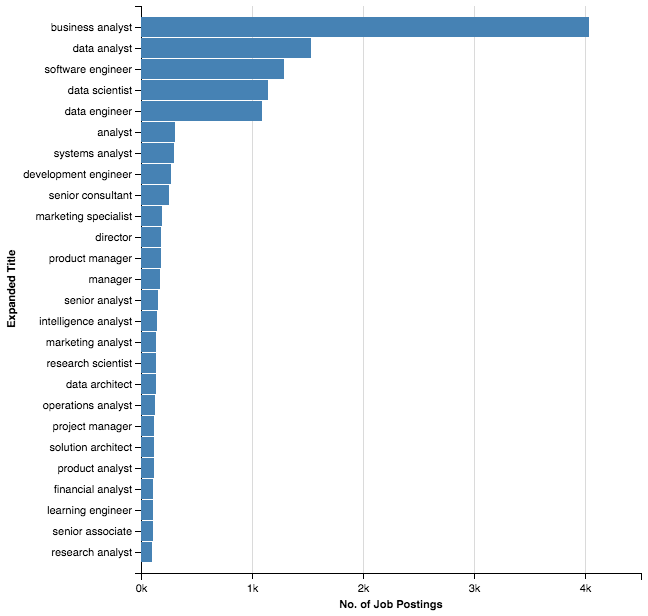

In [59]:
# using the altair plotting library to make these bar charts
Chart(for_eda[['expanded_title','desc_len']]).mark_bar().encode(
    y=Y_axis('expanded_title'
             , axis=Axis(title='Expanded Title')
             , sort=SortField(order='descending', field='expanded_title',op='count')),
    x=X_axis('count(desc_len)'
            , axis=Axis(title='No. of Job Postings')
            ),
    )

### 4.2 What are the longest Posts (by words)

As expected "senior" positions have longer descriptions, typically due to expanded responsibilities and work experience. The shorter descriptions are surprisingly engineering oriented vs. the analyst titles

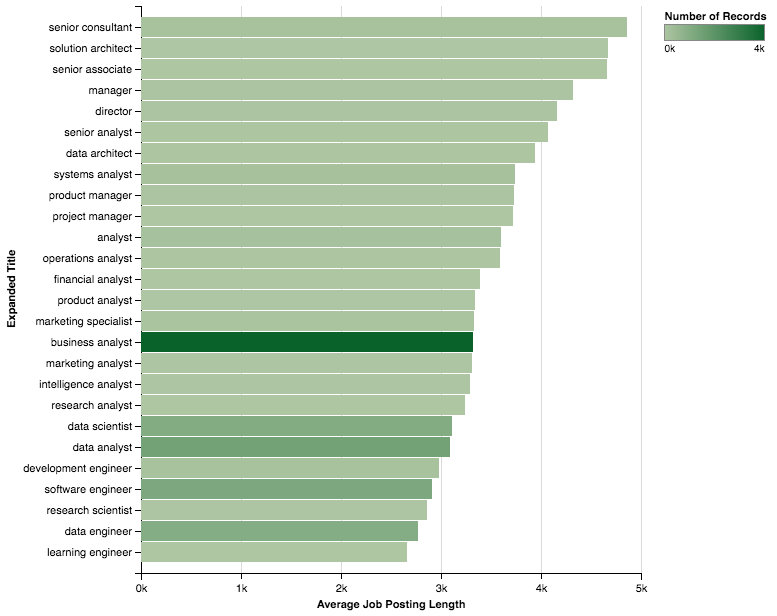

In [61]:
# using the altair plotting library to make these bar charts
Chart(for_eda[['expanded_title','desc_len']]).mark_bar().encode(
    y=Y_axis('expanded_title'
             , axis=Axis(title='Expanded Title')
             , sort=SortField(order='descending', field='desc_len',op='mean')),
    x=X_axis('mean(desc_len)'
             , axis=Axis(title='Average Job Posting Length')
            ),
    color = 'count(desc_len)'
    )

### 4.3 Distribution of postings by Expanded title and State

California in general had the most job postings, followed by washington ,boston, and new york. Surprisingly virgina, georgia, and texas have a decent number of data scientist titled rows vs. 

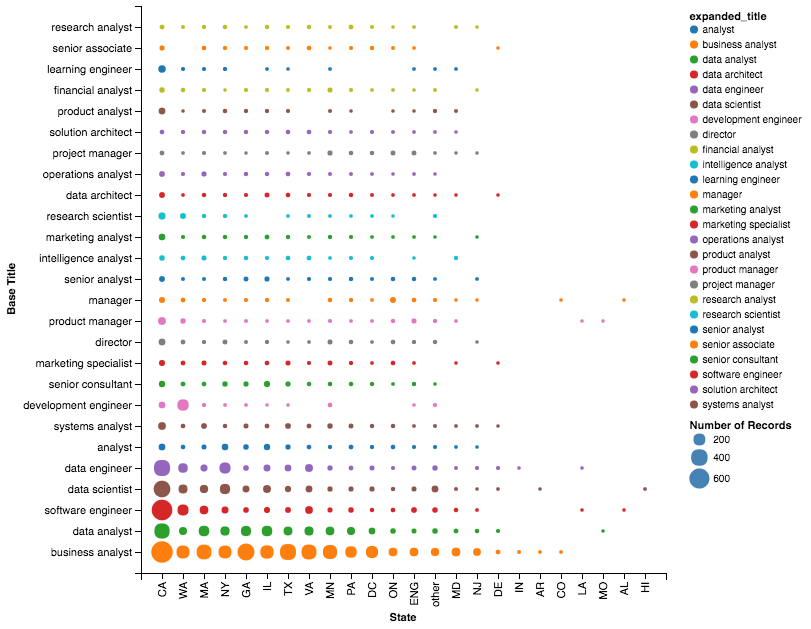

In [62]:
# using the altair plotting library to make these bar charts
Chart(for_eda[['state','expanded_title']]).mark_circle().encode(
    x=X_axis('state'
             , axis=Axis(title='State')
             , sort=SortField(field='expanded_title',op='count',order='descending')),
    y=Y_axis('expanded_title'
             , axis=Axis(title='Base Title')
             , sort=SortField(field='expanded_title',op='count',order='ascending')),
    size='count(expanded_title):Q',
    color= 'expanded_title',
)

### 4.4 Distribution of postings by Expanded title and State

California has the largest market for most generic positions, but there are large concentration in some non-hub places like Boston, Georgia, Illnois, and Virginia, which are not typical cities that people associate with tech


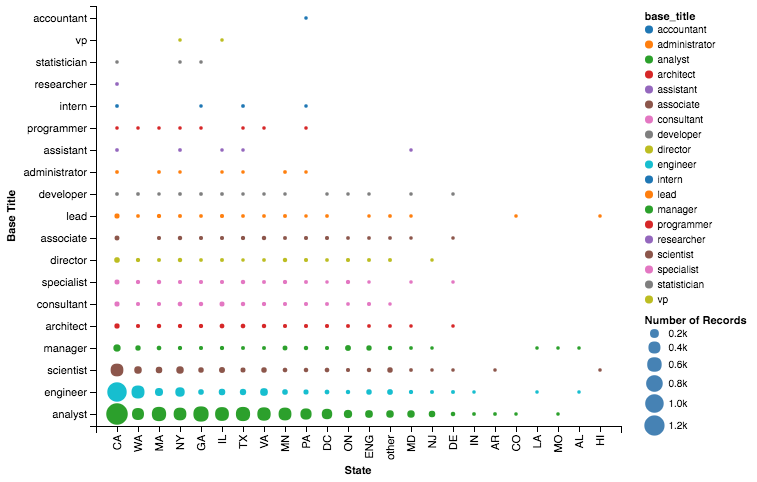

In [63]:
# using the altair plotting library to make these bar charts
Chart(for_eda[['state','base_title']]).mark_circle().encode(
    x=X_axis('state'
             , axis=Axis(title='State')
             , sort=SortField(field='base_title',op='count',order='descending')),
    y=Y_axis('base_title'
             , axis=Axis(title='Base Title')
             , sort=SortField(field='base_title',op='count',order='ascending')),
    size='count(base_title):Q',
    color= 'base_title',
)

### 4.5 Machine Learning shows up in which Expanded Titles?

In a job posting, what is the density of job terms? The following plot shows the breakout. We see that data scientist has the most Machine learning terms, followed by Learning engineer, research scientist, data architects. Data Engineer and Software engineer have a lot of postings with low-machine learning de

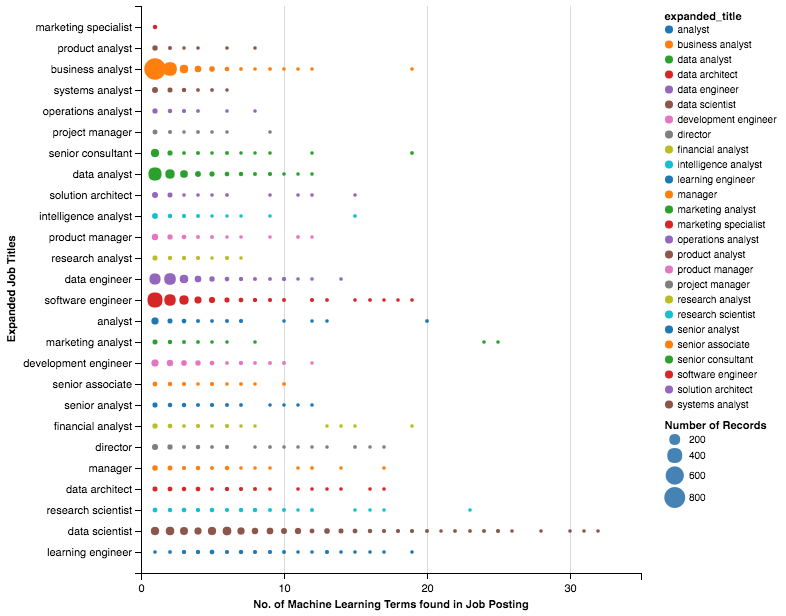

In [64]:
# using the altair plotting library to make these bar charts
Chart(for_eda[['totalterms','expanded_title']]).mark_circle().encode(
    x=X_axis('totalterms'
            ,axis=Axis(title='No. of Machine Learning Terms found in Job Posting')
            ),
    y=Y_axis('expanded_title'
             ,axis=Axis(title='Expanded Job Titles')
             ,sort=SortField(field='totalterms',op='mean',order='ascending')),
    size='count(expanded_title):Q',
    color= 'expanded_title',
).transform_data(
      filter='datum.totalterms >= 1',
        )

### 4.6 Machine Learning terms shows up in which states?

California has the highest concentration of machine learning terms followed by Washington, new york, and boston

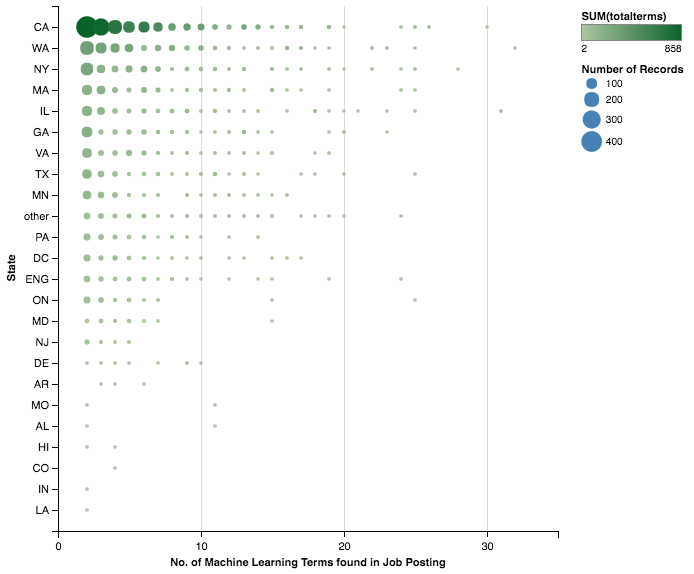

In [65]:
# using the altair plotting library to make these bar charts
Chart(for_eda[['totalterms','state']]).mark_circle().encode(
    x=X_axis('totalterms'
            ,axis=Axis(title='No. of Machine Learning Terms found in Job Posting')
            ),
    y=Y_axis('state'
             ,axis=Axis(title='State')
             ,sort=SortField(field='state',op='count',order='descending')),
    size='count(totalterms):Q',
    color= 'sum(totalterms):Q',
).transform_data(
      filter='datum.totalterms >= 2',
        )

### 4.7 Which companies are posting the most in this space?

From the search terms cited above, which companies showed up the most frequent in the results? Or in other words, who has the widest and largest tech opportunities?


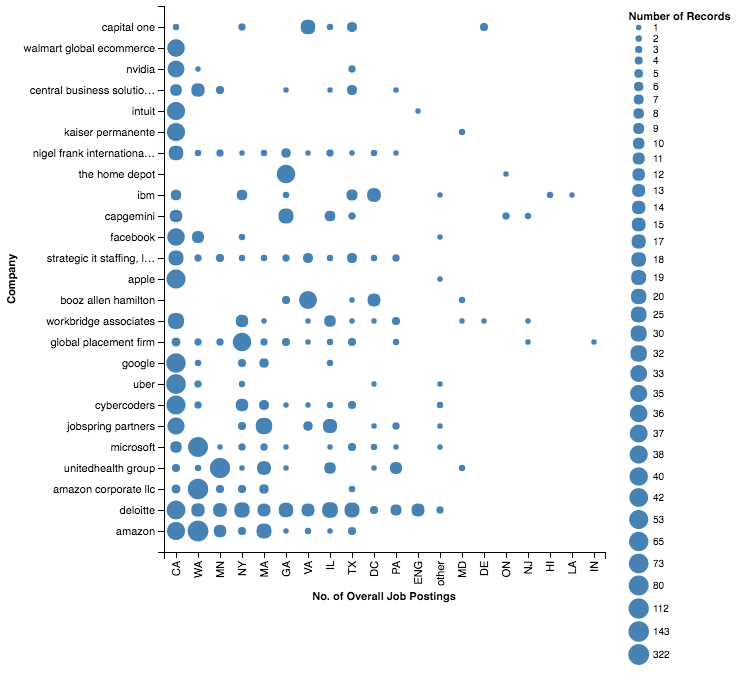

In [66]:
# using the altair plotting library to make these bar charts
Chart(for_eda[['totalterms','state','post_company']]).mark_circle().encode(
    x=X_axis('state'
             ,axis=Axis(title='No. of Overall Job Postings')
             ,sort=SortField(field='post_company',order='descending',op='count')),
    y=Y_axis('post_company'
             ,axis=Axis(title='Company')
             ,sort=SortField(field='post_company'
                             ,order='ascending'
                             ,op='count')),
    size = 'count(post_company)'
).transform_data(
      filter='datum.post_company != "other_co"',
        )

### 4.8 Which Companies have the most Machine-Learning Terminology

Similarly, which of the companies have the highest density of Machine Learning terminology? Amazon and Deloitte currently lead with the most postings and highest density

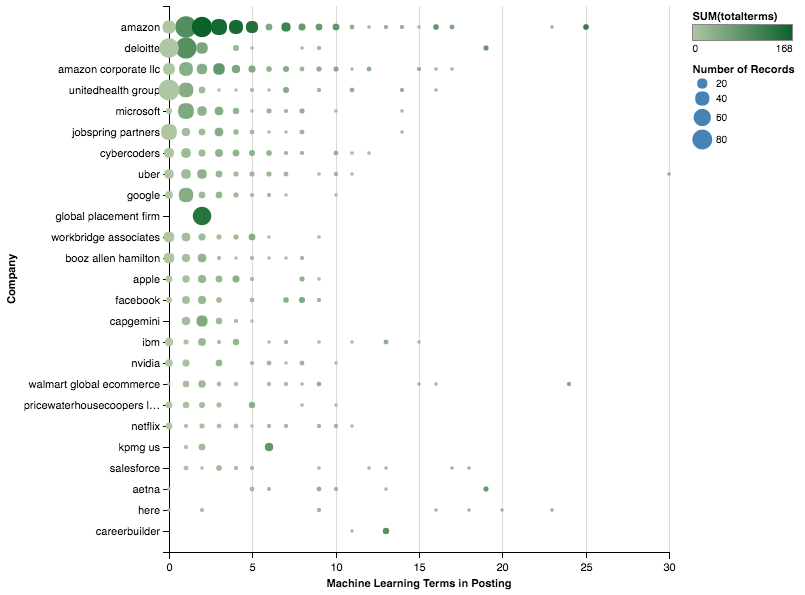

In [67]:
# using the altair plotting library to make these bar charts
Chart(for_eda[['totalterms','term_company']]).mark_circle().encode(
    x=X_axis('totalterms'
             ,axis=Axis(title='Machine Learning Terms in Posting')
            ),
    y=Y_axis('term_company',axis=Axis(title='Company'),sort=SortField(field='totalterms',order='descending',op='count')),
    size='count(totalterms):Q',
    color='sum(totalterms):Q'
).transform_data(
      filter='datum.term_company != "other_co"',
        )

<a id='section5'></a> <a href='#home'>Back to Table of Contents</a>

## 5. Feature Engineering - Job Posting Text

### Cleaning up Lengthy Job Posting: class hardSkillParser


As shown in the sample before, we also try to extract 3 levels of text:

### Full Posting Sample:

This is the 100% of the full raw HTML description pull from webscraping.

---
>US Citizenship Required - TS/SCI with FSP Clearance Required - US Citizenship Required

>Senior CNO Developer to support programs related to computer network operations. You will be integral members of a highly-skilled team that provides on-site development of advanced tools and techniques for use in intelligence collection programs.

>Main responsibilities will include, but are not limited to:
- Analyzing and deconstructing software applications and products
- Working within operating systems to characterize and understand technical specifications

>Required Skills:
- Bachelor's degree in Engineering, Computer Science or related field (4 years of related experience may be substituted for each year of degree-level education)
- 8+ years of related development experience
- 8+ years of development experience in Windows OR Linux environment
- A minimum of one year of experience working in or supporting customers within the Intelligence Community
- 8+ years of demonstrated experience in x86 assembly, SW reverse engineering, kernel debugging, boot procedures, file systems, networking protocol stacks, embedded SW development
- 8+ years of Windows OR Linux kernel/driver development experience
- Strong understanding of operating system internals

>Desired Skills:
- Must present a positive and professional demeanor
- Must possess excellent communication skills, both written and verbal

>Required Education (including Major):
- Bachelor's degree in Engineering, Computer Science or related field (4 years of related experience may be substituted for each year of degree-level education)

### Line Items Only Sample:

These line items are identified by the following conditions:
- There's a new line before
- there's only a single sentence in the block
- If there's more than one sentence between  new line breaks, then ignore
---

>- Analyzing and deconstructing software applications and products
- Working within operating systems to characterize and understand technical specifications

>Required Skills:
- Bachelor's degree in Engineering, Computer Science or related field (4 years of related experience may be substituted for each year of degree-level education)
- 8+ years of related development experience
- 8+ years of development experience in Windows OR Linux environment
- A minimum of one year of experience working in or supporting customers within the Intelligence Community
- 8+ years of demonstrated experience in x86 assembly, SW reverse engineering, kernel debugging, boot procedures, file systems, networking protocol stacks, embedded SW development
- 8+ years of Windows OR Linux kernel/driver development experience
- Strong understanding of operating system internals

>Desired Skills:
- Must present a positive and professional demeanor
- Must possess excellent communication skills, both written and verbal

>Required Education (including Major):
- Bachelor's degree in Engineering, Computer Science or related field (4 years of related experience may be substituted for each year of degree-level education)


### Hard Skills Only Sample:

These hard skills are identified by specific english terms. The proceeding phrase is isolated and considered a "hard skill":

        - in
        - including
        - knowledge of
        - experience with
        - understanding of
        - to
        - develop
        - design
        - requirements

>- experience working in or supporting customers within the Intelligence Community
> - in x86 assembly, SW reverse engineering, kernel debugging, boot procedures, file systems, networking protocol stacks, embedded SW development
> - in Engineering, Computer Science or related field (4 years of related experience may be substituted for each year of degree-level education)
> - experience working in or supporting customers within the Intelligence Community
> - experience in Windows OR Linux environment

### 5.1 hardSkillParser class definition

In [68]:


class hardSkillParser(object):


    def __init__(self,list_of_text):
        # takes in a list of text entries - in this case, list of full job postings
        self.text_dict = [{'text':self._fixText(x)} for x in list_of_text] 
        
    def load(self,list_of_text):
        # if the text list needs to be reloaded
        self.text_dict = [{'text':self._fixText(x)} for x in list_of_text]
        
    # =========================================================
    # this function will do some formatting to the text. 
    # will add newlines to * points (these are used as substitute bullet points)
    # the if cases are also checking to ensure that everythign is ascii formatted
    # there were some odd characters or chinese - related characters that dont play
    # well with the python libraries
    
    # the _ prefix denotes a private function
    def _fixText(self, input_string):
        
        #flag for keeping track of the previous variable
        prevlower = False
        
        # will be our new holder for the new text. Will go segment by segment
        # through the original text and will append the clean text to new holder
        # will eventually return 'new text'
        newText = ''
        
        for x in input_string:
            if x=='*':
                # add new line after *
                newText +='\n'
            elif x.isalpha()==False:
                prevlower=0
            elif x.islower():
                prevlower = True
            if (prevlower == True) & (x.isupper()):
                newText += '.\n' + x
                prevlower = False        
            else:
                newText += x
        return newText
            
    # =========================================================         
    # decodes HTML --> unicode -- > ascii acceptable
    # designed for pandas MAP and APPLY functions
    # the _ prefix denotes a private function
    def _cleanLI(self, yy):
        newlist = []
        for y in yy:
            try:
                # if HTML encoding is present ( %20 etc), then first
                # converting those characters to spaces and punc.
                # then converting everything to ascii
                newlist.append(unidecode.unidecode(y.decode('utf-8')).lower())
            except:
                try:
                    # if no HTML present then converting to ascii
                    newlist.append(y.decode('utf-8').lower())
                except:
                    # if no encoding needs to be done, then the text is added as is
                    newlist.append(y.lower())
        return newlist       
   
    
    # =========================================================
    # pulls newline delinated lines, since these are typically
    # the bullet point descriptions
    # and have a higher percentage of relevant details
    # relating to job instead of disclaimers, or 
    # company background or descriptions
    
    def _parseLI(self,y):
        # stores all the line items identified
        LI = []
        
        # getting rid of the periods in some of the abbreviations
        y  = y.replace('i.e.','-ie-').replace('e.g.','-eg-')
        
        # split by new lines
        for x in y.split('\n'):
            
            # then splitting by periods this will turn newline blocks
            ct = len(x.strip().split('.'))
            
            # into sentences. a single line item will often have 1 sentence
            # the expanded paragraphs are not something that we want (more than 1
            # sentence)
            
            # if single sentence ( no periods)
            if ct ==1:
                if len(x)>0:
                    LI.append(x)
            
            # if 1 period is present, but there is 1 nothing after it or before it
            # check the phrase length and grab the appropriate phrase
            elif len(x.strip().split('.')[1])<=1:
                if len(x.strip().split('.')[0])>0:
                    LI.append(x.strip().split('.')[0])
        return LI

    # =========================================================    
    # this is a generic function used to take in words and return the phrase after it
    # if you put in a "tall farmer experienced in bunny raising and carrot farming"
    # and "experienced" is the split phrase, "in in bunny raising and carrot farming" will be
    # returned 
    
    def _splitLI(self,y,phrase):
        try:
            if phrase in ('to','in'):
                return y.split(' '+phrase+' ')[1]
            else:
                return y.split(phrase)[1]
        except:
            return ''


    # =========================================================
    # the fit section will do the following
    # Full Text -- > line items
    # Line items ---> hard skills (identified by the listed elements)
    
    def fit(self):
        start = datetime.datetime.now()
        
        # these are the terms that will be the prefixing phrases to identify hard skills
        terms = ['in','including','knowledge of','experience with', 'understanding of', 'to','develop ','design ','requirements']
        
        # looping through the text dictionary, posting by posting
        for x in self.text_dict:
            
            # using the function defined above Text --> line items
            x['LI'] =self._cleanLI(self._parseLI(x['text']))
            
            hardskill = []
            
            # for each split term, scan the text and see if the phrase exists and store in separate field
            # so "including" will be a feature with a list of phrases that follow after
            # that preposition
            # all these hardskills are collected per post for a single field called
            # 'hard skil'
            for y in terms:
                x[y] = [self._splitLI(LI,y) for LI in x['LI']]
                x[y] = [z for z in x[y] if z!='']
                hardskill.extend(x[y])
            
            # assigning all the hardskills parsed out
            x['hardskill'] = hardskill
            
            # making a LI-text friendly version for NLP parsing (not a list data structure)
            x['LI_text'] = ' '.join(x['LI'])
            
            # making a hardskill-text friendly version for NLP parsing (not a list data structure)
            x['hardskill_text'] = ' '.join(x['hardskill'])
        print datetime.datetime.now()-start
        
        self.parsed_df = pd.DataFrame(self.text_dict)[['text','LI','LI_text','hardskill','hardskill_text']]
    
    # saving out work incase anything happens later on in the process. using
    # cPickle to store the data

    def save(self,prefix='_'):
        suffix = str(int(time.mktime(datetime.datetime.now().timetuple())))[-6:]
        with open("008_"+prefix+"_parsed_text_dict_"+suffix+".p",'wb') as f:
            pickle.dump(self.text_dict,f)
        with open("008_"+prefix+"_parsed_df_"+suffix+".p",'wb') as f:
            pickle.dump(self.parsed_df,f)



### 5.2 Extracting sub texts with hardSkillParser

Will use the above class to parse the full job descriptions into:

1. Full job posting
2. Just the new-line identified line items
3. Any phrases following after specific prepositions to identify key skills

These parsed text files are saved in list data types to be tokenized

#### Total Job Posting --> Line Item Only --> Hard Skill only

Make 3 tiers of text, the original posting, newline single item collections, and hard skills only text fields for NLP analysis. Job descriptions often have excessively long introductions or context descriptions about the company or specifically have to call out equal opportunity disclaimers, or they talk about the growing industry. Often job postings have a listing broken by new lines, items such as the following:

- Experienced in SQL, Java
- Delivering products on tight deadlines
- Undertanding of big data tools such as Hadoop or Hive
- Communication skills are a must

These are often the meat of the resume, and have been pulled out of the text with some clever list manipulation and text tools. At the next level down, "hard skills" or specific tools are isolated with the following leading phrases: 
**to**, **in**, **experience with**, **knowledge of**,**including**, **requirements**. Splitting on these terms will isolate the following:

- Experienced **in SQL, Java**
- Delivering products on tight deadlines
- **Undertanding of big data tools such as Hadoop or Hive**
- Communication skills are a must


In [69]:
# see class definition above, but running out job posting text for the 
# targetting job titles also identified above

hSP = hardSkillParser(master_total_df.loc[master_total_df['expanded_title'].isin(limittitles)].copy()['jobdesc'])
hSP.fit()

0:00:08.773410


In [70]:
# sample headings
hSP.parsed_df.head(2)

,text,LI,LI_text,hardskill,hardskill_text
0,"\nJob Overview:\n\n\nThe Analyst, Marketing An...","[job overview:, essential functions:, % of tim...",job overview: essential functions: % of time d...,"[a team environment, a matrixed environment, h...",a team environment a matrixed environment high...
1,\nSkyport Systems is developing groundbreaking...,"[qualifications, b, experience in any of these...",qualifications b experience in any of these: s...,"[any of these: spark, druid, hadoop, kafka, sa...","any of these: spark, druid, hadoop, kafka, sam..."


In [71]:
# Check the record counts, to ensure we have the same number of rows.
# will extract for full job posting, Line items, then hard skill texts

fulltext = limited_postings['cleandesc']
LItext = hSP.parsed_df['LI_text']
HStext = hSP.parsed_df['hardskill_text']
print len(fulltext)
print len(LItext)
print len(HStext)

12518
12518
12518


<a id='section6'></a> <a href='#home'>Back to Table of Contents</a>

## 6. NLP - Word Tokenizing

The following NLP Parser class takes in a list of text and automates the following tasks:

- Vectorizing of the different texts into arrays/matrices of words using Count Vectorizer
- Apply stop words filter to get rid of common words
- Corpus creation - an optimized word count data structure (combination of dictionary and tuples)
- vocab creation - remaining unique words

These word features will become the features that will be used for predicting expanded title names. Only the top **20,000** word features (by occurance count) will be used for prediction.

In [72]:
def NLP_parser(text):
    # using count vectorizer to turn the cleaned job descriptions into feadutes
    # note: I also explored using TFIDF parser instead, but the scores were very similar
    # this is in another study which I can post later if anyone is interested
    cvec = CountVectorizer(stop_words='english', lowercase=True,ngram_range=(1,1))
    start_time = datetime.datetime.now()
    cvec.fit(text)

    
    #create a data from from the elements generated from Count Vectorizer
    cdf  = pd.DataFrame(cvec.transform(text).todense(),
                 columns=cvec.get_feature_names())

    #keeping the top 20,000 features (or words)
    summary = cdf.sum().sort_values(ascending = False)
    keep_cols = summary[:20000].index
    cdf_to_merge = cdf[keep_cols]


    # since some of the words are reserved, adding NLP_ as a prefix to stop any type of compiler issues
    cdf_to_merge.columns = ['nlp_'+x for x in cdf_to_merge.columns]
    return cdf_to_merge

### Parse Text - Full Job Postings, Line Items, Hard Skills

Will use the above class to parse the full text into word features

In [1]:
# creating the word matrices for our three versions of the text.
# the full text
# the line item text
# also the hardskill text
full_df = NLP_parser(fulltext)
LI_df = NLP_parser(LItext)
HS_df = NLP_parser(HStext)

print full_df.shape, LI_df.shape, HS_df.shape

NameError: name 'NLP_parser' is not defined

<a id='section7'></a> <a href='#home'>Back to Table of Contents</a>

## 7. Splitting data into X(features) and Y(targets)

#### One vs. rest classification - y as a matrix

In a normal classification, logistic regression can be  used to separate 2 classes. So for 2 classes, 1 logistic regression can be used, represented by a y vector of [n_rows]. Since this analysis will be classifying 26 different classes, 25 different logistic regressions are required. So instead of the following for a single class:

Single Case

    y = [ 0 , 0 , 0 , .. 1, 0 ,0]
   
For multiclass y becomes a matrix, 

    y = [[ 0 , 0 , 0 , .. 1, 0 ,0]
            [ 0 , 0 , 0 , .. 1, 0 ,0]
            [ 0 , 0 , 0 , .. 1, 0 ,0]
            ...
            [ 0 , 0 , 0 , .. 1, 0 ,0]]
            
An extremely useful classes are 
    
    from sklearn.preprocessing import MultiLabelBinarizer

The multiLabelBinarizer is very similar to patsy, but specifically for y and will turn  mulit-class vector into an matrix with n_classes - 1 x n_rows. For X, the main features are the various vectorized word counts. These counts only range from 1-5 per posting, so scaling won't be used.

In [74]:
# this function bundles a bunch of the data-processing functions together
# feature extracting, and preparation of X and y for predictive model design

def generateXY(base_dataframe, word_df):
    
    # this is the patsy block to pull out the basic features.
    # can't use this with all the word features because patsy has a # of feature limit
    # will have to do this manually below
    formula = 'expanded_title ~ company + city + state + desc_len -1'
    print formula
    y, X = patsy.dmatrices(formula, base_dataframe, return_type='dataframe')
    # will ignore the y value for the matrix below

    # this merges in all the countvectorizer Word features extracted from above.
    X = X.merge(word_df, how = 'left', left_index=True,right_index=True)
    print X.shape

    # turns y into a multi class matrix
    # 2 classes require a single vector n multiclassification requires n-1 matrix
    mlb = MultiLabelBinarizer()
    y = mlb.fit_transform([[x] for x in limited_postings['expanded_title']])
    print mlb.classes_
    print y.shape
    return y, X, mlb

#after the class is defined, we can make a simple call below
y, X, mlb = generateXY(limited_postings, full_df)

expanded_title ~ company + city + state + desc_len -1
(12518, 25762)
['analyst' 'business analyst' 'data analyst' 'data architect'
 'data engineer' 'data scientist' 'development engineer' 'director'
 'financial analyst' 'intelligence analyst' 'learning engineer' 'manager'
 'marketing analyst' 'marketing specialist' 'operations analyst'
 'product analyst' 'product manager' 'project manager' 'research analyst'
 'research scientist' 'senior analyst' 'senior associate'
 'senior consultant' 'software engineer' 'solution architect'
 'systems analyst']
(12518, 26)


<a id='section8'></a> <a href='#home'>Back to Table of Contents</a>

## 8. Classification Function - setup to take models for one vs. rest library

#### Multiclass classification

The classification approach will be for 26 different classes. The modeling will be performed by using logistic regression class by class, or basically 26 different models. This is for one modeling run. So for however many runs that need to be tested it will be 26 times. 

Python sklearn has a prebuilt function called :
        - OneVsRestClassifier

This OneVsRestClassifier is a generic utility that can take a model and run it multiple times for multiclass classification. For each training, the model will run 26 different tests such as : data analyst vs. rest, then engineer vs. rest, and then data scientist vs. the rest. To reduce the code bloat, the following function was designed below.

In [75]:
# defined a function to run multi-class Logistic regression. Called it multigress
# does the test train split, cross val,
# fittting of the model
# the prediction
# the scoring
# returns fitted model

def multiGres(model, X,y, gs='no',params=None, cv=5):
    # the input model can be anything, but in our study we will use
    # logistic regression, regularization, and decision tree for comparison
    
    #splitting data for cross validation
    X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2)
    print X_train.shape, X_test.shape, y_train.shape, y_test.shape

    #start the timer
    start = datetime.datetime.now()

    #proto typer functionality if grid search also needed to identify key parameters
    if (params==None) or (gs=='no'):
        
        #non-grid search model
        # --- note y is a matrix
        #initialize the one vs. rest classifier, fit and score     
        OVRC = OneVsRestClassifier(model,n_jobs=-1)
        
        # fitting 
        OVRC.fit(X_train,y_train)
        
        # report training and test scores
        print datetime.datetime.now()-start
        print 'train score'
        print OVRC.score(X_train,y_train)
        scores = OVRC.score(X_test,y_test)
        print 'test score'
        print scores
        
        #return the model for further analysis
        return scores, OVRC
    else:
        # ran into performance issues, so this part of the code was not implemented
        # AWS choked due to the number of runs that were required
        
        print 'place to implement Grid search version'
#         OVRC = OneVsRestClassifier(model,n_jobs=-1)	    
#         srchr = GridSearchCV(OVRC,cv=cv, param_grid=params, n_jobs=-1)
#         srchr.fit(X_train,y_train)

#         print 'gridscearch score'
#         print srchr.best_score_
#         print srchr.best_params_
#         OVRC_best = srchr.best_estimator_
#         OVRC_best.fit(X_train,y_train)
#         print OVRC_best.score(X_train,y_train)
#         best_score = OVRC_best.score(X_test,y_test)
#         print 'actual test score'
#         print best_score
#         return best_score, OVRC_best

<a id='section9'></a> <a href='#home'>Back to Table of Contents</a>

## 9. Modeling Sample : Basic Logistic Regression

Dataset | Log | L1 C=0.01 | L1 C=0.1 | L1 C=1.0 | L1 C=10.0 | L1 C=100.0 | Random Forest|
--------|-----|-----------|----------|----------|-----------|------------|-----------|
Full Text|x|x|x|x|x|x|x
Line Items Only|x|x|x|x|x|x|x
Hard Skills only |x|x|x|x|x|x|x

#### Modeling code:

Will run 21 times for the above combinations. The below is a sample code block that will be run for multiple times. The logistic regression will use One Vs Rest to do multi-class classification, and will use the liblinear solver.

#### Post Modeling:
The following sections will show a sample of post-model processing, how to extract the following:

- predictions
- top word features per predicting class names
- top alternative class options ordered by probability

In [76]:
# basic sample of modeling
start = datetime.datetime.now()

# initializing a non-regularized logistic regression
lgr = LogisticRegression(n_jobs=-1)

# passing model into our handy function above, and will pop out a score
score , OVRC = multiGres(lgr, X, y)
print datetime.datetime.now() - start

#it's not listed in this book, but a looped version of this will be run
# for multiple different models, but not in this book

(10014, 25762) (2504, 25762) (10014, 26) (2504, 26)
0:02:54.147988
train score
0.978330337527
test score
0.64017571885
0:03:51.366942


### Initial Baseline Modeling results

#### Logistic Classification training score: 0.97

#### Logistic Classification test score: 0.641

#### Comments: 

The overall score is above the baseline, the large difference in the training score vs. the actual test score seems to indicate overfitting. As a result, regularization will be applied to reduce the overfitting of the training set and make it more generalized. In terms of regularization, lasso will be used due to the large number of features created from NLP 

#### Jump to section 15 (all versions of logistic regression run) <a href='#section15'>link</a>

<a id='section10'></a> <a href='#home'>Back to Table of Contents</a>

## 10. Post-Modeling Sample: Reporting Top Features for a Expanded Title

This will take the fitted OneVsRestClassifier and pull out the final model and pull the beta coefficients and match them with the words to find the top features for the predictions. This will take the fitted estimator model, pull out the beta coefficients, and will use them to identify top word features.

### Function: pulling features per expanded title

In [77]:
# top features ( or words per title)
def topFeatMulti(OVRC, bin_class_list, X_columns):
    
    # need the fitted model to be supplied
    # top features are identified by the beta coefficients from the model
    coefs = []
    for x in OVRC.estimators_:
        coefs.append(x.coef_) 
    fitfeat_dict = {}
    
    # now that we have the top beta constants
    # we do a lookup to find the proper word labels for each beta
    # limit 5 ----->
    for x,y in zip(bin_class_list, coefs):
        coef_lkup = {abs(m):(m,n) for m,n in zip(y[0],X_columns)}
        top5 = np.sort(abs(y))[0][::-1][:10]
        top5_labeld = [coef_lkup[m] for m in top5]
        print '='*60
        print x
        for m in top5_labeld:
            print m
        fitfeat_dict[x] = top5_labeld
    
    return fitfeat_dict

In [78]:
fitfeat_dict = topFeatMulti(OVRC, mlb.classes_, X.columns)

analyst
(-0.65043848419256312, 'state[T.CA]')
(0.63891374641350696, u'nlp_chicago')
(-0.59336304735776113, u'nlp_seeking')
(0.51321661019684517, u'nlp_spend')
(0.50239162263130055, u'nlp_tracking')
(-0.49093286498406741, u'nlp_conduct')
(0.4849190183752089, 'city[T.New York]')
(0.47689379411179178, u'nlp_contribute')
(-0.4702884645578701, u'nlp_machine')
(-0.46675880303179346, u'nlp_python')
business analyst
(-1.0867213476103983, u'nlp_machine')
(-0.78755498933406387, u'nlp_entry')
(0.77948395941958015, u'nlp_departments')
(-0.76545111437030189, u'nlp_etl')
(-0.74903104801861164, u'nlp_spark')
(0.73689595042823819, u'nlp_mindset')
(-0.72656986760608311, u'nlp_python')
(-0.70995940996605034, u'nlp_quarterly')
(0.67141024747824585, u'nlp_inovalon')
(-0.66533046749451252, u'nlp_mathematical')
data analyst
(-0.6831724277982435, u'nlp_phd')
(-0.55995925146375114, u'nlp_java')
(0.54720017068802496, u'nlp_hardware')
(0.5281166070670551, u'nlp_looker')
(-0.51155953107313501, u'nlp_build')
(-0.

<a id='section11'></a> <a href='#home'>Back to Table of Contents</a>

## 11. Post-Modeling Sample:  Matching Top Guesses per post

Taking advantage of hte fact that our y is a matrix as shown below:

Predicted:

    y = [class1 | class2 | class3 | class4]
        [ 0.,        1.,        0.,      0.]
        [ 1.,        0.,        0.,      0.]
        
Predicted Probaility:

    y = [class1 | class2 | class3 | class4]
        [ .21,      .87,      0.01,     0.31]
        [ .93,       .34,      0.14,     0.45]

Using the matrix of probabilities, we can find the 2nd,3rd, 4th .. other classes

In [79]:
def topGuesses(OVRC, X, original, mlb):
    
    # from the fit model
    # run the predicted probabilities
    proba = OVRC.predict_proba(X)
    print proba.shape
    
    # make a data frame and rename the columns with the expanded titles 
    df = pd.DataFrame(proba)
    df.columns = mlb.classes_
    
    # will return a short list of the top 3-4 highest probability titles
    # so for a data analyst (real title), will return a list of 
    # predicted titles arranged by top probabilities
    
    def topPredict(y):
        top3 = y.transpose().sort_values(ascending=False)[:4]
        return [(x,z) for x,z in zip(top3.index, top3)]
    
    
    # will store this data in the dataframe for future analysis
    df['top_pred'] = df.apply(topPredict,axis=1)
    results = original.merge(df[['top_pred']], how='left', left_index=True, right_index=True)
    results['yhat'] = results['top_pred'].map(lambda x: x[0][0]) 
    return results


In [80]:
# pulling top  guesses for a fitted model as defined above
predicted = topGuesses(OVRC, X, limited_postings,mlb)

(12518, 26)


Sample of top predicted expanded titles for the first 6 rows

In [81]:
# print our predictions
for i in range(6):
    print predicted['expanded_title'][i], 
    print '\n\t'.join([str(x) for x in predicted['top_pred'][i]])


analyst ('analyst', 0.95862073134751768)
	('marketing analyst', 0.059266590623615487)
	('data analyst', 0.019339782577849091)
	('business analyst', 0.0021779830782466532)
data engineer ('data engineer', 0.93155700939562236)
	('software engineer', 0.058671612618438208)
	('development engineer', 0.014736880130543022)
	('data analyst', 0.0090829185579387305)
business analyst ('business analyst', 0.98157522822189613)
	('analyst', 0.016693129518987364)
	('financial analyst', 0.0033622754370037818)
	('data analyst', 0.0032983314155506584)
data analyst ('data analyst', 0.91329206042811473)
	('business analyst', 0.3163341035731641)
	('director', 0.018364109089625661)
	('operations analyst', 0.012208497401921833)
data analyst ('data analyst', 0.8486736719139667)
	('business analyst', 0.033396409015089959)
	('analyst', 0.0034980232749006615)
	('senior analyst', 0.0020566914997424829)
data scientist ('data scientist', 0.82055088508263663)
	('data analyst', 0.26724396087483149)
	('manager', 0.0244

<a id='section12'></a> <a href='#home'>Back to Table of Contents</a>

## 12. Post-Modeling: For each Post, getting top word counts

For each posting, the top words will be counted and appended as as descending list for further analysis. This is after stop words, so many common words will be filtered out, and will be specific to the post. This level of detail will be used for error analysis

In [82]:
print X.shape
X.head(2)

(12518, 25762)


,"company[""k"" line america, inc.]",company[/cadent/],company[041-concentra solutions inc (concentra)],company[1-800 flowers],"company[1-800-flowers.com, inc.]",company[10th magnitude],"company[10th magnitude, inc.]",company[1199seiu family of funds],company[1871],company[1a auto],...,nlp_rps,nlp_protech,nlp_prospectively,nlp_proserv,nlp_smartly,nlp_perceives,nlp_perc,nlp_curse,nlp_arrived,nlp_arrogance
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0


In [83]:
# this will go through each of hte postings and count the number of times
# that a word will show up in a posting
# this is a little more complext because we want it per posting, and not global ranking
# so each posting has to be summarized, ordered, and then reported. Each will have a different
# set of top words

topwords_perdoc = []
X_t = X.transpose()
i=0
for j in X_t.columns:
    if i % 100 == 0:
        print i,
    tmp = X_t.iloc[:,i].sort_values(ascending=False)
    tmp = tmp[tmp>1][1:]
    topwords_perdoc.append([(index, x) for index,x in tmp.iteritems()])
    i+=1

0 100 200 300 400 500 600 700 800 900 1000 1100 1200 1300 1400 1500 1600 1700 1800 1900 2000 2100 2200 2300 2400 2500 2600 2700 2800 2900 3000 3100 3200 3300 3400 3500 3600 3700 3800 3900 4000 4100 4200 4300 4400 4500 4600 4700 4800 4900 5000 5100 5200 5300 5400 5500 5600 5700 5800 5900 6000 6100 6200 6300 6400 6500 6600 6700 6800 6900 7000 7100 7200 7300 7400 7500 7600 7700 7800 7900 8000 8100 8200 8300 8400 8500 8600 8700 8800 8900 9000 9100 9200 9300 9400 9500 9600 9700 9800 9900 10000 10100 10200 10300 10400 10500 10600 10700 10800 10900 11000 11100 11200 11300 11400 11500 11600 11700 11800 11900 12000 12100 12200 12300 12400 12500


#### This is a sample of top words for a few of the postings

In [84]:
topwords_perdoc[:5]

[[(u'nlp_marketing', 11.0),
  (u'nlp_loyalty', 10.0),
  (u'nlp_analysis', 8.0),
  (u'nlp_ability', 7.0),
  (u'nlp_business', 6.0),
  (u'nlp_skills', 6.0),
  (u'nlp_work', 5.0),
  (u'nlp_analytics', 4.0),
  (u'nlp_environment', 4.0),
  (u'nlp_experience', 4.0),
  (u'nlp_using', 4.0),
  (u'nlp_support', 4.0),
  (u'nlp_responsible', 4.0),
  (u'nlp_sas', 3.0),
  (u'nlp_macy', 3.0),
  (u'nlp_job', 3.0),
  (u'nlp_excel', 3.0),
  (u'nlp_objects', 3.0),
  (u'nlp_ms', 3.0),
  (u'nlp_project', 3.0),
  (u'nlp_effectiveness', 3.0),
  (u'nlp_sql', 3.0),
  (u'nlp_concepts', 2.0),
  (u'nlp_general', 2.0),
  (u'nlp_financial', 2.0),
  (u'nlp_excellent', 2.0),
  (u'nlp_inclusive', 2.0),
  (u'nlp_time', 2.0),
  (u'nlp_customers', 2.0),
  (u'nlp_quality', 2.0),
  (u'nlp_communication', 2.0),
  (u'nlp_statistical', 2.0),
  (u'nlp_segmentation', 2.0),
  (u'nlp_customer', 2.0),
  (u'nlp_tools', 2.0),
  (u'nlp_process', 2.0),
  (u'nlp_software', 2.0),
  (u'nlp_team', 2.0),
  (u'nlp_mathematical', 2.0),
  (u'

<a id='section13'></a> <a href='#home'>Back to Table of Contents</a>

## 13. Basic Logistic Regression - Assembled results table

The baseline table of job postings with expanded titles is then merged with top class predictions and top words listings

In [85]:
# setting new field with a series processed in section 12
predicted['topword_ct'] = topwords_perdoc

#### This is a sample of assembled results from our previous processing all contained in a single data frame

In [86]:
# limiting the predicted table to only the features that can be easily understood (ignoring some of the other  features added earlier)
predicted[['expanded_title'
           ,'base_title'
           ,'company'
           ,'city'
           ,'state'
           ,'jobdesc'
           ,'desc_len'
           ,'totalterms'
           ,'top_pred'
           ,'yhat'
           ,'topword_ct'
          ]].head(3)

,expanded_title,base_title,company,city,state,jobdesc,desc_len,totalterms,top_pred,yhat,topword_ct
0,analyst,analyst,macy's,New York,NY,"job overview: the , marketing analytics is...",3190,1.0,"[(analyst, 0.958620731348), (marketing analyst...",analyst,"[(nlp_marketing, 11.0), (nlp_loyalty, 10.0), (..."
1,data engineer,engineer,skyport systems,Mountain View,CA,"skyport systems is developing groundbreaking,...",1426,0.0,"[(data engineer, 0.931557009396), (software en...",data engineer,"[(nlp_data, 5.0), (nlp_experience, 4.0), (nlp_..."
2,business analyst,analyst,"iqlogg, inc",Dallas,TX,"iqlogg, inc. is an equal opportunity employer...",2373,0.0,"[(business analyst, 0.981575228222), (analyst,...",business analyst,"[(nlp_projects, 4.0), (nlp_trends, 4.0), (nlp_..."


## 13.1 Looking at title similarity - based on probabilities

Since we have similar options for different postings, we can make a correlation matrix based on the probabilities

```
Post #1 : analyst ('analyst', 0.97124201971635582)
	('data analyst', 0.09224897854402879)
	('marketing analyst', 0.025353417134555477)
	('intelligence analyst', 0.00020392029014586449)
Post #2 : data engineer ('data engineer', 0.94262491122939063)
	('software engineer', 0.032009124051313669)
	('data scientist', 0.0073729054476535522)
	('development engineer', 0.0065031250470106144)
```

#### Prep the data for charting

In [87]:
# pandas function to unpack the single cell with a list of tuples into multiple pandas column features
def pivot_pred(x):
    for y in x['top_pred']:
        x[y[0]] = y[1]
    return x
class_to_class = predicted[['expanded_title','top_pred']].apply(pivot_pred,axis =1)

In [88]:
# melting the table for altair plotting. Turning the multiple columns into an additional field with multiple options 
class_to_class_long = pd.melt(class_to_class,id_vars = 'expanded_title'
                              ,value_vars = [x for x in class_to_class.columns if x not in ['expanded_title','top_pred']]
                              , value_name='proba')

# dropping zeros
class_to_class_long.dropna(axis=0
                           ,inplace =True)

# getting rid of the cases when title and predicted are the same, these will have very high predictions
class_to_class_long = class_to_class_long[class_to_class_long['variable']!=class_to_class_long['expanded_title']]

class_to_class_long.head(3)


,expanded_title,variable,proba
2,business analyst,analyst,0.016693
4,data analyst,analyst,0.003498
6,intelligence analyst,analyst,0.003221


## 13.2 Expanded Title to Expanded Title Similarities

#### How to read the chart
Y-axis are the real titles
X-axis are the predictions
The size of the dot shows how probable the two titles are related. For instance, true "systems analyst" and predicted "research analyst" have a 0.8 probability from the model

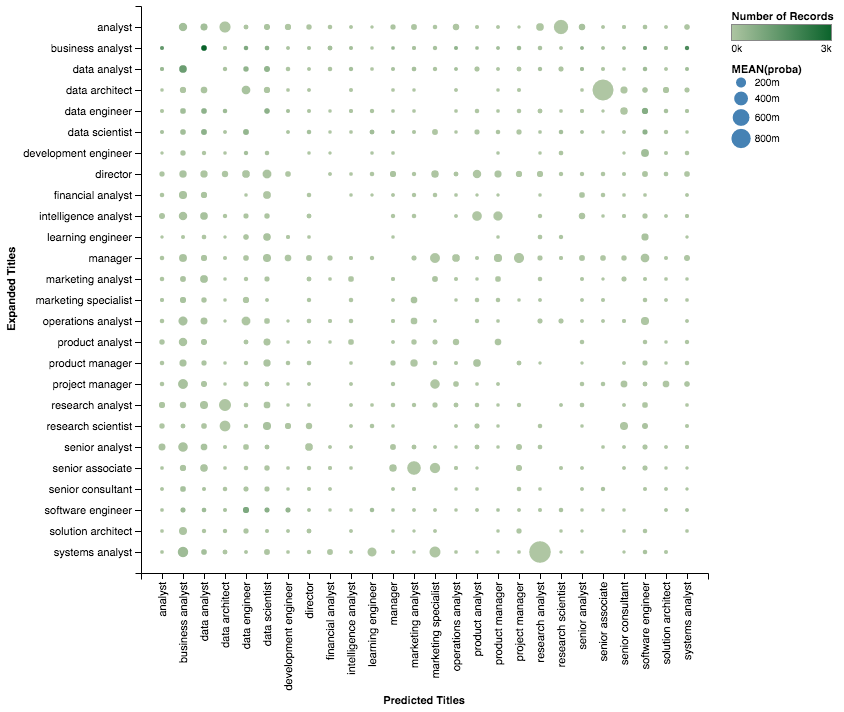

In [173]:
Chart(class_to_class_long).mark_circle().encode(
    x=X_axis('variable'
             , axis=Axis(title='Predicted Titles')
            ) 
             ,
    y=Y_axis('expanded_title'
             , axis=Axis(title='Expanded Titles')
             ),
    size = 'mean(proba)',
    color = 'count(proba)'
)

In [92]:
# this function manipulates our predicted data table 
# to a altair-friendly format for a specific type of chart.

def plotTitleToTitle(predicted):
    
    # pandas function to unpack the single cell with a list of tuples into multiple pandas column features
    def pivot_pred(x):
        for y in x['top_pred']:
            x[y[0]] = y[1]
        return x
    class_to_class = predicted[['expanded_title','top_pred']].apply(pivot_pred,axis =1)
    
    # melting the table for altair plotting. Turning the multiple columns into an additional field with multiple options 
    class_to_class_long = pd.melt(class_to_class,id_vars = 'expanded_title'
                                  ,value_vars = [x for x in class_to_class.columns if x not in ['expanded_title','top_pred']]
                                  , value_name='proba')

    # dropping zeros
    class_to_class_long.dropna(axis=0
                               ,inplace =True)

    # getting rid of the cases when title and predicted are the same, these will have very high predictions
    class_to_class_long = class_to_class_long[class_to_class_long['variable']!=class_to_class_long['expanded_title']]

    c = Chart(class_to_class_long).mark_circle().encode(
    x='variable',
    y='expanded_title',
    size = 'mean(proba)',
    color = 'count(proba)'
    )
    return c
#c = plotTitleToTitle(predicted)
#c

## 13.3 Expanded Title to Word Similarities - Data Prep

Per job post, there is a vectorized word count per posting. This will be extracted and compared per title

    jobpost:'data analyst'-- [(u'nlp_data', 5.0),
      (u'nlp_experience', 4.0),
      (u'nlp_location', 3.0),
      (u'nlp_skyport', 2.0),
      (u'nlp_restful', 2.0),
      (u'nlp_understanding', 2.0),
      (u'nlp_api', 2.0),
      (u'nlp_knowledge', 2.0),
      (u'nlp_backend', 2.0),
      (u'nlp_team', 2.0),
      (u'nlp_developing', 2.0),
      (u'nlp_make', 2.0),
      
All the words will be unpacked for each job posting and will be used to see top words occurance across expanded titles

In [93]:
# used to unpack the stored list of tuples in the pandas data frame
# will create specifc features for each words extracted 
# word count has already been prefiltered to counts over >2 per pandas cell.
def pivot_words(x):
    for y in x['topword_ct']:
        x[y[0]] = y[1]
    return x

class_to_words = predicted[['expanded_title','topword_ct']].apply(pivot_words,axis =1)

In [94]:
# the number of words pulled out. There's around 12,293 distinct words that can be used as features
class_to_words.shape

(12518, 12293)

#### Melt the dataframe for altair charting input

In [95]:
# the pandas dataframe with numerous word features is then melted into a long table for altair usage
class_to_words_long = pd.melt(class_to_words,id_vars = 'expanded_title'
                              ,value_vars = [x for x in class_to_words.columns if x not in ['expanded_title','topword_ct']]
                              , value_name='count')
class_to_words_long.dropna(axis=0,inplace =True)
class_to_words_long.head(6)

,expanded_title,variable,count
178,business analyst,nlp_00,2.0
192,business analyst,nlp_00,2.0
281,research analyst,nlp_00,2.0
337,data analyst,nlp_00,2.0
406,business analyst,nlp_00,2.0
485,senior associate,nlp_00,2.0


#### Limit number of words so its readable

In [96]:
# since there are 12k different word terms, we will only pull the top 50 so that charting won't be too crazy
# will do top 50 by count over all expanded titles
top_terms = class_to_words_long.variable.value_counts()[:50]

In [97]:
ctw_plot = class_to_words_long[class_to_words_long['variable'].isin(top_terms.index)]
ctw_plot.head()

,expanded_title,variable,count
4030796,analyst,nlp_ability,7.0
4030800,data analyst,nlp_ability,2.0
4030801,data scientist,nlp_ability,3.0
4030802,intelligence analyst,nlp_ability,2.0
4030803,intelligence analyst,nlp_ability,3.0


## 13.4 Expanded Title to Word Similarities

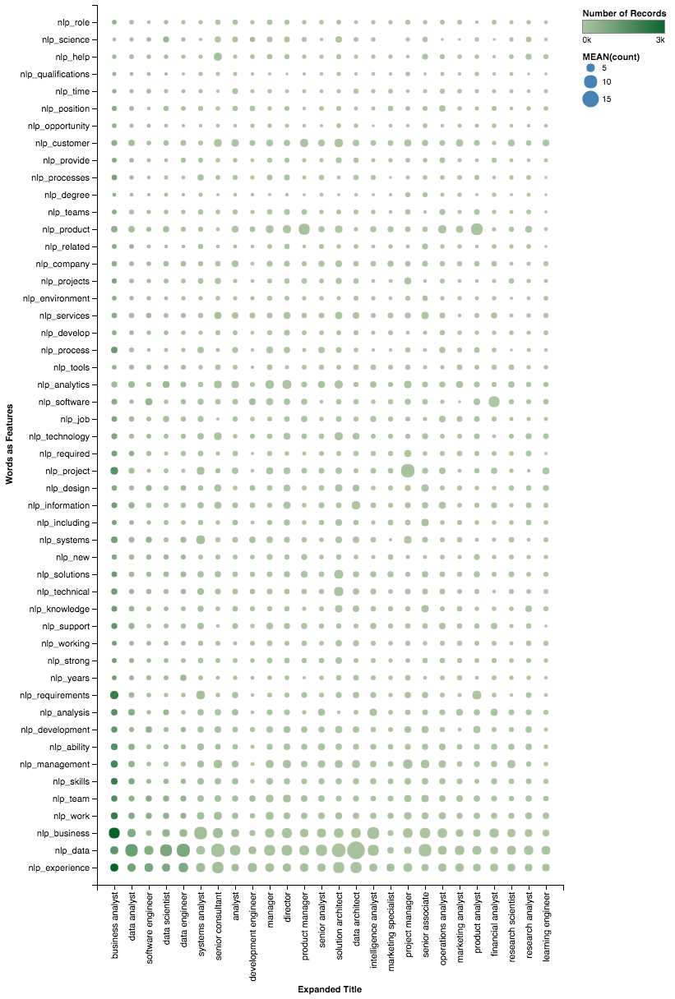

In [98]:
Chart(ctw_plot).mark_circle().encode(
    y=Y_axis('variable'
             , axis=Axis(title='Words as Features')
             , sort=SortField(field='mean',order='ascending',op='count')),
    x=X_axis('expanded_title'
             , axis=Axis(title='Expanded Title')
             ,sort=SortField(field='mean',order='descending',op='count')),
    size = 'mean(count)',
    color = 'count(count)',
)

In [99]:
# functionalize it!
def plotTitleToWords(predicted):
    # used to unpack the stored list of tuples in the pandas data frame
    # will create specifc features for each words extracted 
    # word count has already been prefiltered to counts over >2 per pandas cell.
    def pivot_words(x):
        for y in x['topword_ct']:
            x[y[0]] = y[1]
        return x

    class_to_words = predicted[['expanded_title','topword_ct']].apply(pivot_words,axis =1)
    # the pandas dataframe with numerous word features is then melted into a long table for altair usage
    class_to_words_long = pd.melt(class_to_words,id_vars = 'expanded_title'
                                  ,value_vars = [x for x in class_to_words.columns if x not in ['expanded_title','topword_ct']]
                                  , value_name='count')
    class_to_words_long.dropna(axis=0,inplace =True)

    # since there are 12k different word terms, we will only pull the top 50 so that charting won't be too crazy
    # will do top 50 by count over all expanded titles
    top_terms = class_to_words_long.variable.value_counts()[:50]
    ctw_plot = class_to_words_long[class_to_words_long['variable'].isin(top_terms.index)]
    c = Chart(ctw_plot).mark_circle().encode(
        y=Y_axis('variable',sort=SortField(field='mean',order='ascending',op='count')),
        x=X_axis('expanded_title',sort=SortField(field='mean',order='descending',op='count')),
        size = 'mean(count)',
        color = 'count(count)',
    )
    return c

<a id='section14'></a> <a href='#home'>Back to Table of Contents</a>

# 14. Scoring - Confusion Matrix, ROC for multiclass

## 14.1 Scoring - Bad Predictions


The following section is an EDA of the bad predictions, exploring which titles are difficult to predict and why.

** Re-testing a clean test set with basic logistic regression **

In [100]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3)
OVRC.fit(X_train,y_train)

OneVsRestClassifier(estimator=LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=-1,
          penalty='l2', random_state=None, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False),
          n_jobs=-1)

#### Recheck our score

In [101]:
print OVRC.score(X_test,y_test)

0.617412140575


#### Store the predictions for different scoring techniques

In [102]:
y_proba = OVRC.predict_proba(X_test)
y_hat = OVRC.predict(X_test)
y_score = OVRC.decision_function(X_test)

In [103]:
y_proba[0]

array([  5.48425842e-08,   1.44366373e-04,   4.65399363e-02,
         5.88200532e-06,   9.67756245e-01,   5.31946839e-03,
         3.65815233e-07,   3.79009926e-05,   2.04967590e-07,
         2.04185889e-03,   5.95642567e-05,   2.53707165e-04,
         2.59365202e-08,   7.31148378e-07,   1.59222119e-05,
         1.39485258e-06,   3.84176724e-06,   1.94166628e-06,
         1.02406831e-06,   8.86779124e-06,   1.95028170e-05,
         9.44072820e-07,   2.70666796e-08,   2.69641247e-03,
         3.08482361e-05,   2.73423989e-05])

#### Pulling out the predicted titles

Note: since it is multiclass, it is possible for a single posting to be predicted as multiple different classes, though the probabilities will be different. The first section will collect all prediction choices

In [104]:
y_hat_words = []

# our predictions at this point are a unlabeled array/row of probabilities
# will need to associate the actual titles with these numbers
for yy in y_hat:
    cur_list = []
    for zz in np.argwhere(yy>0):
        cur_list.append(mlb.classes_[zz[0]])
    y_hat_words.append(cur_list)
y_hat_words = np.array(y_hat_words)

The next set will pull the top choice by highest probability. In this case there can only be 1 top option per

In [105]:
# now that that is setup, will only pull the top probability as the best choice
# this is an assumption as for most logistic regression anything over 0.5 is considered a "yes"
y_hat_proba_words = []
for yy in y_proba:
    y_hat_proba_words.append(mlb.classes_[yy.argmax()])
y_hat_proba_words = np.array(y_hat_proba_words)
    

Assign these additional features to the dataframe for further failure EDA

In [106]:
# adding fields to the original data set of limited postings
test_compare = limited_postings.ix[X_test.index,:].copy()
test_compare['predicted_title'] = y_hat_proba_words
test_compare['predicted_options'] = y_hat_words
test_compare['predicted_options_len'] = test_compare['predicted_options'].map(lambda x : len(x))

In [107]:
#total test size:
print test_compare.shape

(3756, 25)


Data prep for chart 14.1 - pulling items where there was more than 1 prediction for that job posting

In [108]:
# how many had multiple positive predictions?
print len(test_compare[test_compare['predicted_options_len']>1])
multi_pred = test_compare[test_compare['predicted_options_len']>1][['expanded_title']]
multi_pred.head(2)

208


,expanded_title
4829,business analyst
4097,solution architect


### 14.1 Which Titles also multiple predictions?

Which titles could have been assigned to multiple job titles? Business analyst as the most generic, is in the lead along with data analyst (which is similiarly generic) runs behind it.

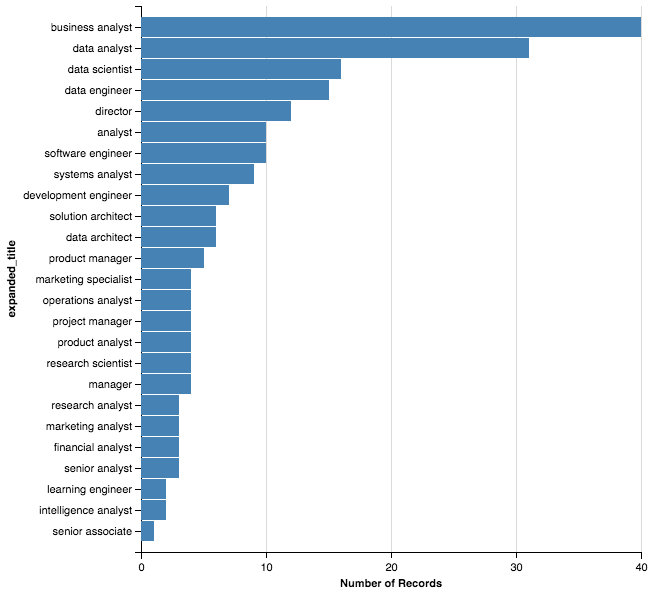

In [109]:
Chart(multi_pred).mark_bar().encode(
    y=Y_axis('expanded_title', sort=SortField('expanded_title',order='descending', op='count')),
    x='count(expanded_title):Q',
)

### 14.2 Which Titles where wrong ? (~30% incorrect)

In [110]:
#test_compare[(test_compare['predicted_options_len']>1) & (test_compare['expanded_title']=='business analyst')]['predicted_options']

In [111]:
# pulling out when real title isnt equal to the predicted title
wrong_ans = test_compare[test_compare['predicted_title'] !=  test_compare['expanded_title']][['expanded_title','predicted_title']]
print wrong_ans.shape

(1005, 2)


#### which titles were mistaken the most

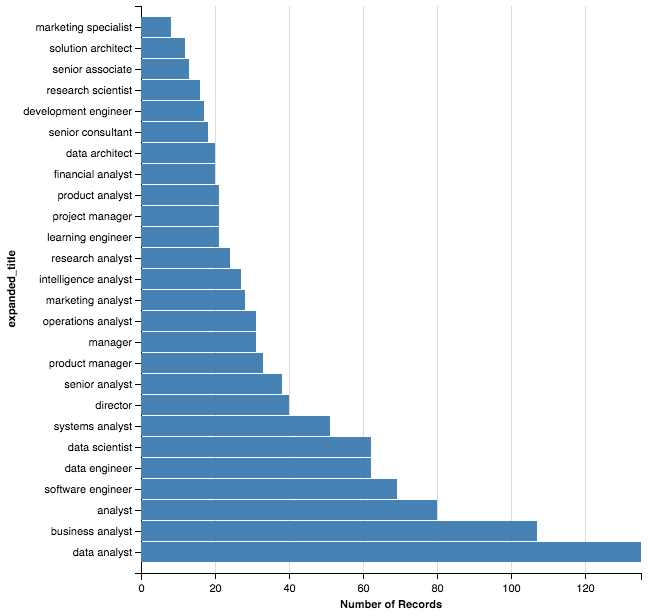

In [112]:
Chart(wrong_ans).mark_bar().encode(
    y=Y_axis('expanded_title', sort=SortField('expanded_title',order='ascending',op='count')),
    x ='count(*)',
)

#### If it was wrong, how wrong was it, and what other titles were most mistaken for it?

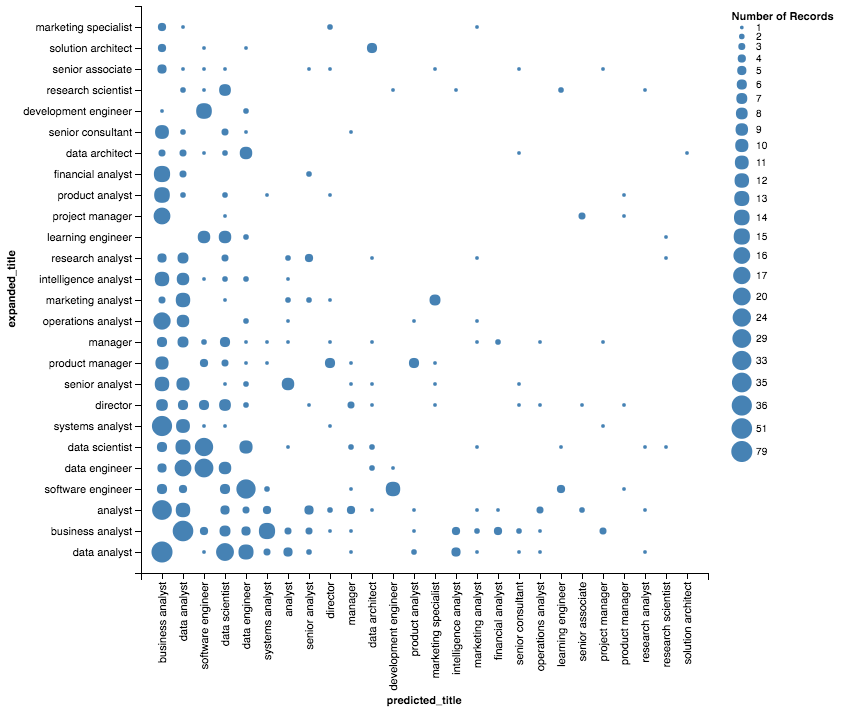

In [113]:
Chart(wrong_ans).mark_circle().encode(
    y=Y_axis('expanded_title'
             , axis = Axis(title='Expanded Title')
             , sort=SortField('expanded_title',order='ascending', op='count')),
    x = X_axis('predicted_title'
               , axis = Axis(title='Predicted Title')
               , sort=SortField('expanded_title',order='descending', op='count')),
    size='count(expanded_title)',
)

### 14.3 Scoring - Confusion Matrix for multiclass

Currently in SKLearn, there is no metric support for multi-class classification. See the posting:

http://scikit-learn.org/stable/modules/multiclass.html

Previously we turned a single column (12k rows) with 26 different options into a  12k by 26 matrix. We will now take the prediction matrix and ravel it down into a single vector so we can use the built-in confusion matrix library.

    Y predict matrix     Y predict vector
    [ 0 1 0 0 0 0]
    [ 0 0 0 0 0 1] ---- > [2, 7, ..]


Confusion matrix, without normalization


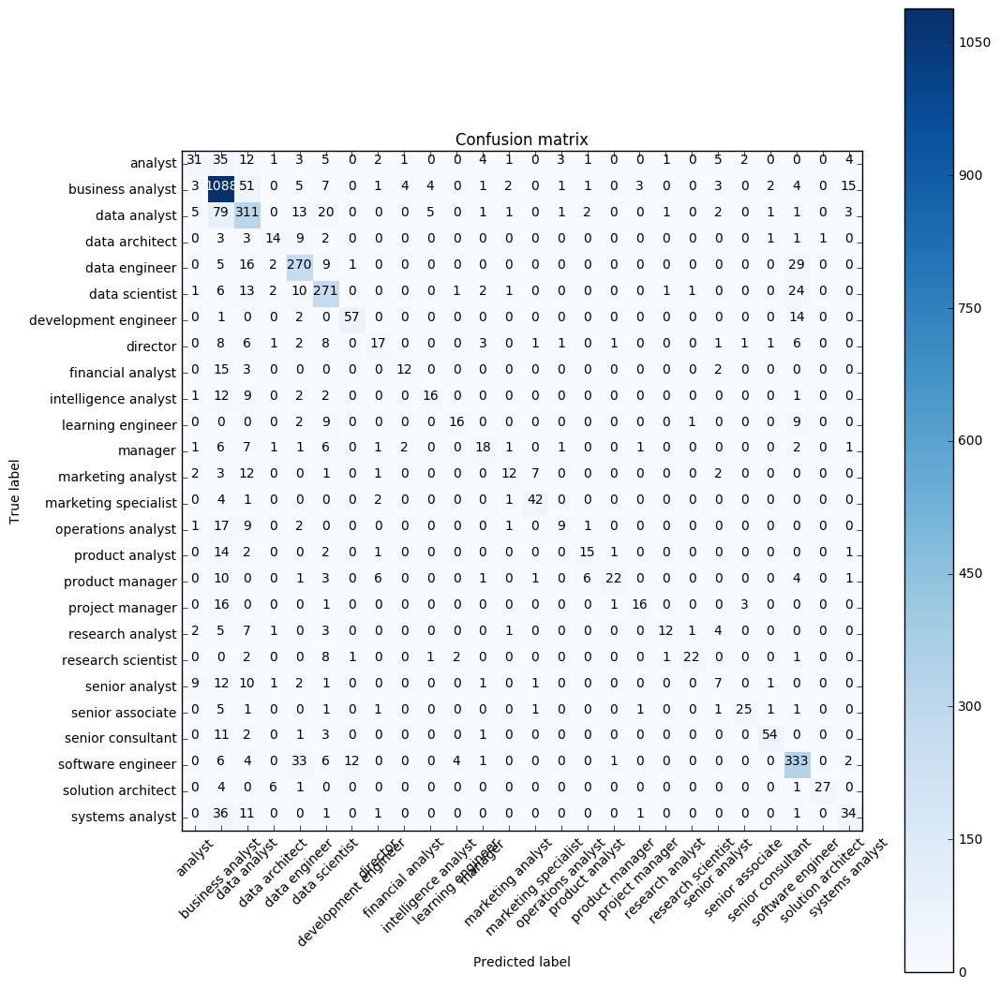

In [114]:
y = test_compare['expanded_title']
yp = test_compare['predicted_title']

import matplotlib.pyplot as plt
import itertools
cnf_matrix= confusion_matrix(y,yp)


def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    #print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    
plt.figure(figsize=(11,11))
plot_confusion_matrix(cnf_matrix, classes=mlb.classes_,
                      title='Confusion matrix')
plt.show()

## 14.4 Scoring - ROC for multiclass

The difficulty with multi-class is that there's a single model that accounts for the classification multiple classes. Each of these classes will have its own ROC curve. The following picture was made from a looping function and represents all classes.

In [115]:
np.mean(abs(np.ravel(y_test - y_hat)))

0.020439092324076348

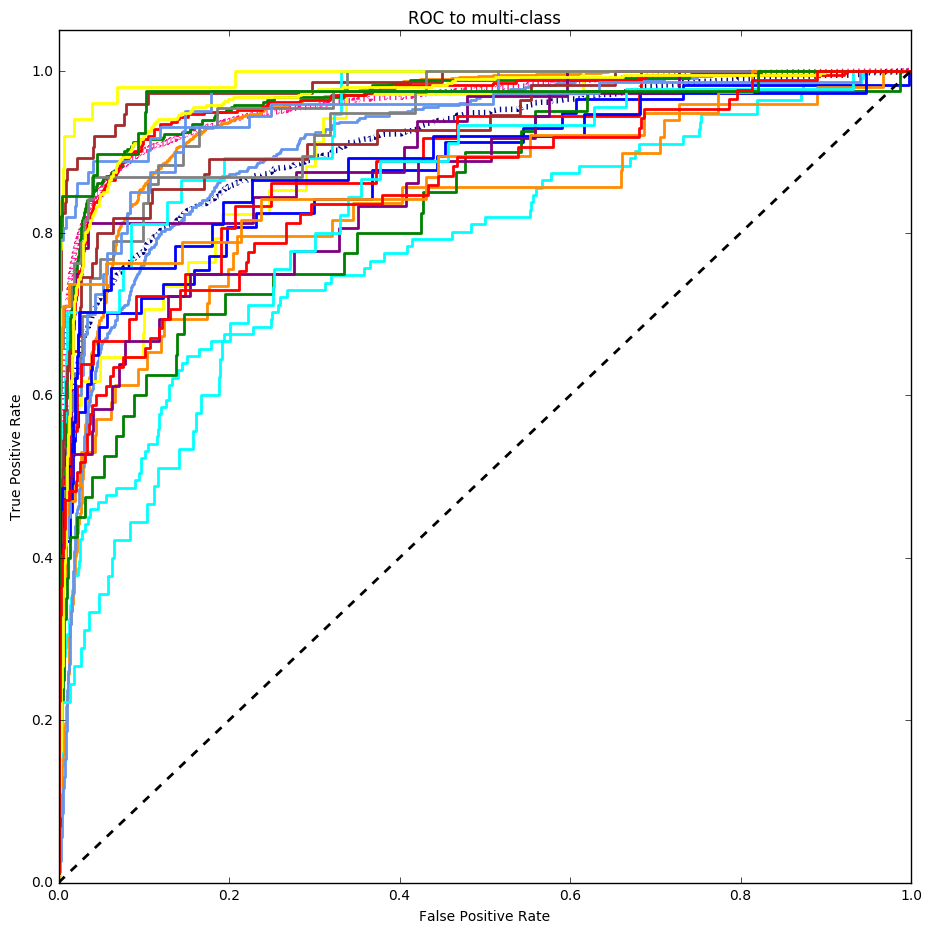

In [116]:
import matplotlib.pyplot as plt
from itertools import cycle


lw = 2 # line width
n_classes = len(limittitles)
# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])


# Plot all ROC curves
plt.figure(figsize=(11,11))
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = cycle(['aqua', 'darkorange', 'cornflowerblue','yellow','green','red','brown','blue','purple','grey'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC to multi-class')
#plt.legend(loc="lower right")
plt.show()

### The worst performer is class 14, the best is 5,6,13,17,23 



In [117]:
mlb.classes_[14]

'operations analyst'

In [118]:
mlb.classes_[[5,6,13,17,23]]

array(['data scientist', 'development engineer', 'marketing specialist',
       'project manager', 'software engineer'], dtype=object)

<a id='section15'></a> <a href='#home'>Back to Table of Contents</a>

## 15. Applying Regularization

Importing data from the bulk processor:

Tests that were run:

Dataset | Log | L1 C=0.01 | L1 C=0.1 | L1 C=1.0 | L1 C=10.0 | L1 C=100.0 | Random Forest|
--------|-----|-----------|----------|----------|-----------|------------|-----------|
Full Text|x|x|x|x|x|x|x
Line Items Only|x|x|x|x|x|x|x
Hard Skills only |x|x|x|x|x|x|x

#### Pulling AWS processed Results

In [119]:
# the multiGres class was run repeatedly on a large AWS instance for speed purposes
# the code was run and pickled and the results are pickled and reopened below for analysis 

import cPickle as pickle
import pandas as pd
from pprint import pprint
model_path = '/Users/tlee010/desktop/dsi-capstone/99-Reports/MULTILOG_RESULTS.p'

with open(model_path, 'rb') as f:
    results_storage = pickle.load(f)

#### Process stored Dictionary into a table of results

In [120]:
# this section parses the stored results into a pada friendly table format

list_of_list = []
for k,v in results_storage.iteritems():
    list_of_list.append([k,str(v['test_score']), str(v['train_score'])])

#pd.DataFrame(list_of_list)
df_log_res = pd.DataFrame(list_of_list)
df_log_res['C'] = df_log_res[0].map(lambda x : float(x.split('L1')[1]) if 'L1' in x else 0. )
df_log_res['dataset'] = df_log_res[0].map(lambda x : x.split('L1')[0] if 'L1' in x else x )
df_log_res['logres'] = df_log_res[0].map(lambda x : 'logres' if 'LOG' in x else 'non' )
df_log_res['logC'] = df_log_res['C'].map(lambda x : np.log(x) if np.log(x)!=-np.Inf else 0 )
df_log_res.columns = ['ref','test_score','train_score','C','dataset','logres','logC']
df_log_res

,ref,test_score,train_score,C,dataset,logres,logC
0,LI_LOGL10.01,0.275559105431,0.269023367286,0.01,LI_LOG,logres,-4.605170
1,FULL_LOGL110,0.607428115016,0.99930097863,10.00,FULL_LOG,logres,2.302585
2,FULL_LOG,0.613019169329,0.980127821051,0.00,FULL_LOG,logres,0.000000
3,HS_LOG,0.423322683706,0.75374475734,0.00,HS_LOG,logres,0.000000
4,FULL_LOGL10.1,0.526357827476,0.615538246455,0.10,FULL_LOG,logres,-2.302585
5,FULL_LOGL10.01,0.352236421725,0.381266227282,0.01,FULL_LOG,logres,-4.605170
6,LI_LOGL11.0,0.533546325879,0.874176153385,1.00,LI_LOG,logres,0.000000
7,FULL_LOGL1100,0.597843450479,0.999700419413,100.00,FULL_LOG,logres,4.605170
8,FULL_LOGL11.0,0.618610223642,0.983922508488,1.00,FULL_LOG,logres,0.000000
9,FULL_RFC,0.499600638978,0.999700419413,0.00,FULL_RFC,non,0.000000


In [121]:
df_log_res.sort_values(by=['dataset','C'],ascending=False)

,ref,test_score,train_score,C,dataset,logres,logC
19,LI_RFC,0.430910543131,0.999500699021,0.00,LI_RFC,non,0.000000
13,LI_LOGL1100,0.527955271565,0.997503495107,100.00,LI_LOG,logres,4.605170
12,LI_LOGL110,0.542731629393,0.996305172758,10.00,LI_LOG,logres,2.302585
6,LI_LOGL11.0,0.533546325879,0.874176153385,1.00,LI_LOG,logres,0.000000
14,LI_LOGL10.1,0.409345047923,0.475434391851,0.10,LI_LOG,logres,-2.302585
0,LI_LOGL10.01,0.275559105431,0.269023367286,0.01,LI_LOG,logres,-4.605170
11,LI_LOG,0.55071884984,0.916916317156,0.00,LI_LOG,logres,0.000000
20,HS_RFC,0.379792332268,0.999500699021,0.00,HS_RFC,non,0.000000
18,HS_LOGL1100,0.433306709265,0.988416217296,100.00,HS_LOG,logres,4.605170
10,HS_LOGL110,0.437300319489,0.983423207509,10.00,HS_LOG,logres,2.302585


#### Plotting the Regularized scores

#### Note: no regularization is around higher log C values. The scores flat line after Log C = 2+

In [122]:
# this section parses the stored results into a pada friendly table format
toplot = pd.melt(df_log_res[df_log_res['logres']=='logres']
                 ,id_vars =['logC','dataset']
                 ,value_vars=['test_score','train_score']
                 ,value_name = 'score'
                 )
toplot['plotset'] = toplot['dataset'] + '_' + toplot['variable']


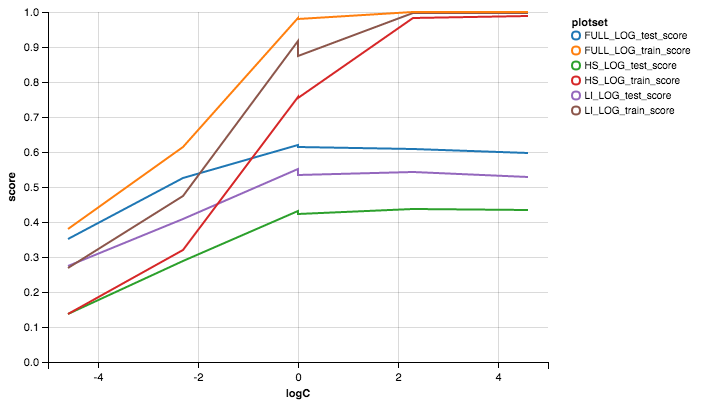

In [123]:
Chart(toplot).mark_line().encode(
    y='score:Q',
    x='logC:Q',
    color='plotset',
)

### Discussion 

1. **Full Text Scored Higher overall**: Though there is an excess of words, overall, the score increased with volume of words. Full Text > Line Item Text > Hard Skill Text

2. **Overfit without regularization**: With no regularization ( log C), there is severe overfitting in the training model. WIth training scores around 0.9 and testing scores around 0.6, the model is over fit. As we can see from the curves, increasing the regularization (decreasing C) will bring the scores closer togehter, but will lower the over all score down, so there's a tradeoff

3. **Final choice : LogC = -2 , or C=0.1 **: At this point the train score is around .615, and the test is .524, which is very close, without sacrificing too much of the over all score

#### Create Tabular Format of the NLP related results

In [124]:
res_df_topterms = pd.DataFrame({'baseline': np.zeros(len(limittitles)) })
res_df_topterms.index = [x for x in limittitles]
res_df_topterms.head()
for k,v in results_storage.items():
    if 'RFC' not in k:
        res_df_topterms.loc[v['fitfeature_dict'].keys(),k] = v['fitfeature_dict'].values()
#reordering columns
ordered = res_df_topterms.columns.sort_values()
res_df_topterms = res_df_topterms[ordered]

In [125]:
res_df_topterms

,FULL_LOG,FULL_LOGL10.01,FULL_LOGL10.1,FULL_LOGL11.0,FULL_LOGL110,FULL_LOGL1100,HS_LOG,HS_LOGL10.01,HS_LOGL10.1,HS_LOGL11.0,HS_LOGL110,HS_LOGL1100,LI_LOG,LI_LOGL10.01,LI_LOGL10.1,LI_LOGL11.0,LI_LOGL110,LI_LOGL1100,baseline
business analyst,"[(-0.992521367488, nlp_machine), (-0.728011760...","[(-0.684185713534, nlp_machine), (-0.342692514...","[(-1.32229333779, nlp_machine), (-0.6897887313...","[(-3.4244520229, city[T.Mount Laurel]), (-2.68...","[(5.99564780946, nlp_pasadena), (-5.9244409096...","[(8.71951527265, city[T.- Illinois - Chicago])...","[(-1.03142537781, nlp_java), (-0.794317302237,...","[(-1.03142537781, nlp_java), (-0.794317302237,...","[(-1.03142537781, nlp_java), (-0.794317302237,...","[(-1.03142537781, nlp_java), (-0.794317302237,...","[(-1.03142537781, nlp_java), (-0.794317302237,...","[(-1.03142537781, nlp_java), (-0.794317302237,...","[(-1.73067220427, nlp_ph), (-1.6188444478, nlp...","[(-0.415926816757, nlp_analytics), (-0.4030692...","[(-1.66350269522, nlp_ph), (-1.29655709862, nl...","[(-3.27904302276, nlp_ph), (3.20491154413, nlp...","[(-9.54918558122, nlp_technique), (8.875644349...","[(-12.2173092823, company[ettain group]), (11....",0.0
data analyst,"[(-0.892020978093, nlp_phd), (-0.854645628328,...","[(-0.421446149772, nlp_machine), (-0.247395995...","[(-0.662305331313, nlp_aws), (0.614708459083, ...","[(-3.54220814466, nlp_relies), (-2.55570946245...","[(6.00278339706, nlp_hellowallet), (5.92873667...","[(8.96320175703, nlp_stockholm), (8.8186289558...","[(-1.36717942259, company[amazon]), (1.1173837...","[(-1.36717942259, company[amazon]), (1.1173837...","[(-1.36717942259, company[amazon]), (1.1173837...","[(-1.36717942259, company[amazon]), (1.1173837...","[(-1.36717942259, company[amazon]), (1.1173837...","[(-1.36717942259, company[amazon]), (1.1173837...","[(-2.48974448643, nlp_scientist), (-1.92036950...","[(-0.436243867411, nlp_machine), (0.2580897764...","[(-1.50453017806, nlp_scientist), (-1.10917380...","[(4.65286185227, nlp_progressing), (-3.7099772...","[(10.9655033182, nlp_tcm), (10.1365922777, nlp...","[(15.8398484099, company[appleone employment s...",0.0
software engineer,"[(0.845278442081, nlp_javascript), (-0.6794071...","[(0.460274616103, nlp_javascript), (0.28311867...","[(-0.966195673113, company[amazon]), (0.884757...","[(-2.63233612263, company[amazon]), (2.5051155...","[(5.84506266762, company[peekabuy, inc.]), (-4...","[(8.7647327564, company[mylikes]), (7.35877897...","[(-1.52469407173, company[amazon]), (-1.220318...","[(-1.52469407173, company[amazon]), (-1.220318...","[(-1.52469407173, company[amazon]), (-1.220318...","[(-1.52469407173, company[amazon]), (-1.220318...","[(-1.52469407173, company[amazon]), (-1.220318...","[(-1.52469407173, company[amazon]), (-1.220318...","[(-1.78233149955, nlp_analyst), (-1.5432129223...","[(0.511115303452, nlp_java), (-0.439899340409,...","[(-1.34854509272, nlp_analyst), (-1.155234527,...","[(-4.31928725949, nlp_modify), (-3.83364295957...","[(7.35384088356, company[trunk club]), (7.0362...","[(13.169393428, company[yik yak, inc.]), (12.5...",0.0
data scientist,"[(-1.1125565971, nlp_30), (-0.950028743528, nl...","[(0.471493469544, nlp_statistics), (0.31102107...","[(-0.79452484939, nlp_excel), (-0.638242787908...","[(2.06757059689, nlp_ezrapenland), (-1.8920589...","[(4.82092100891, nlp_kibana), (4.43770296415, ...","[(8.22455864747, nlp_gnu), (6.99095870444, nlp...","[(1.13646610668, nlp_scientist), (-1.085917974...","[(1.13646610668, nlp_scientist), (-1.085917974...","[(1.13646610668, nlp_scientist), (-1.085917974...","[(1.13646610668, nlp_scientist), (-1.085917974...","[(1.13646610668, nlp_scientist), (-1.085917974...","[(1.13646610668, nlp_scientist), (-1.085917974...","[(3.68631111327, nlp_scientist), (-1.909238892...","[(1.42753593771, nlp_scientist), (-0.399517274...","[(2.38682400644, nlp_scientist), (-1.177724165...","[(4.32548688264, nlp_scientist), (-4.297460935...","[(-11.1690399053, company[nvidia]), (9.0970738...","[(14.0882

<a id='section16'></a> <a href='#home'>Back to Table of Contents</a>

## 16. Revisiting model with regularized Model C=0.01

The following section will replot the standard charts outlined above, but with the regularized model


In [126]:
y, X, mlb = generateXY(limited_postings, full_df)

start = datetime.datetime.now()
lgr = LogisticRegression(n_jobs=-1, penalty='l1', C=0.1, max_iter=1000)
score , OVRC_l1 = multiGres(lgr, X, y)
print datetime.datetime.now() - start

expanded_title ~ company + city + state + desc_len -1
(12518, 25762)
['analyst' 'business analyst' 'data analyst' 'data architect'
 'data engineer' 'data scientist' 'development engineer' 'director'
 'financial analyst' 'intelligence analyst' 'learning engineer' 'manager'
 'marketing analyst' 'marketing specialist' 'operations analyst'
 'product analyst' 'product manager' 'project manager' 'research analyst'
 'research scientist' 'senior analyst' 'senior associate'
 'senior consultant' 'software engineer' 'solution architect'
 'systems analyst']
(12518, 26)
(10014, 25762) (2504, 25762) (10014, 26) (2504, 26)
0:03:23.695502
train score
0.617335729978
test score
0.513977635783
0:04:23.984087


Since the scores are more consistent, will do an overall predictive analysis:

In [127]:
# 10
fitfeat_dict_l1 = topFeatMulti(OVRC_l1, mlb.classes_, X.columns)

#11
predicted_l1 = topGuesses(OVRC, X, limited_postings,mlb)

#12 -- based on X normal, nothing changes here - just a count by input text
# topwords_perdoc = []
# X_t = X.transpose()
# i=0
# for j in X_t.columns:
#     if i % 100 == 0:
#         print i,
#     tmp = X_t.iloc[:,i].sort_values(ascending=False)
#     tmp = tmp[tmp>1][1:]
#     topwords_perdoc.append([(index, x) for index,x in tmp.iteritems()])
#     i+=1

#13
predicted_l1['topword_ct'] = topwords_perdoc

analyst
(0.50984803631967612, u'nlp_smg')
(0.49804109249039913, u'nlp_comcast')
(0.4836141251854279, u'nlp_bulletin')
(0.45674662218019252, 'city[T.New York]')
(-0.3927541498100986, u'nlp_python')
(-0.38262958114720602, u'nlp_cloud')
(0.3495079520564745, u'nlp_analyses')
(0.30624396162837797, u'nlp_uw')
(0.28894206477988316, u'nlp_languages')
(-0.27971470572065738, u'nlp_machine')
business analyst
(-1.2671479094364537, u'nlp_machine')
(-0.62766887226109391, u'nlp_python')
(-0.61978769042040927, u'nlp_spark')
(-0.50103176723478282, u'nlp_hadoop')
(-0.46633737689126331, u'nlp_bsa')
(0.44680729953156506, u'nlp_mindset')
(-0.44439944329044834, u'nlp_follows')
(-0.44304975192317858, u'nlp_quarterly')
(-0.41390006382106359, u'nlp_java')
(0.40697992743827816, u'nlp_ba')
data analyst
(0.57186773291357229, u'nlp_abuse')
(-0.53844009672838866, u'nlp_machine')
(-0.47103007768446459, u'nlp_java')
(0.46946719792577934, u'nlp_looker')
(-0.42577020170115965, u'nlp_pipelines')
(0.41698707045299976, u'

### Getting the Confusion Matrix - for multiclass

**Accuracy:** Overall, how often is the classifier correct?
- (TP+TN)/total

**Misclassification Rate:** Overall, how often is it wrong?
- (FP+FN)/total
- equivalent to 1 minus Accuracy
- also known as "Error Rate"

**True Positive Rate (Recall):** When it's actually yes, how often does it predict yes?
- TP/actual yes
- also known as "Sensitivity"

**False Positive Rate:** When it's actually no, how often does it predict yes?
- FP/actual no = 10/60 = 0.17

**Specificity:** When it's actually no, how often does it predict no?
- TN/actual no = 50/60 = 0.83
- equivalent to 1 minus False Positive Rate

**Precision:** When it predicts yes, how often is it correct?
- TP/predicted yes = 100/110 = 0.91

**Prevalence:** How often does the yes condition actually occur in our sample?
- actual yes/total = 105/165 = 0.64


In [137]:
conf_data = predicted_l1[['expanded_title','yhat']]

In [140]:
dist_title = 'analyst'
conf_data[(conf_data['expanded_title'] == dist_title) & (conf_data['yhat'] == dist_title) ].shape[0]

228

In [150]:
conf_mtx = []
for dist_title in conf_data.expanded_title.unique():
    actual_ = conf_data[conf_data['expanded_title'] == dist_title].shape[0]
    predicted_ = conf_data[conf_data['yhat'] == dist_title].shape[0]
    TP = conf_data[(conf_data['expanded_title'] == dist_title) & (conf_data['yhat'] == dist_title) ].shape[0]
    FP = conf_data[(conf_data['expanded_title'] != dist_title) & (conf_data['yhat'] == dist_title) ].shape[0]
    TN = conf_data[(conf_data['expanded_title'] != dist_title) & (conf_data['yhat'] != dist_title) ].shape[0]
    FN = conf_data[(conf_data['expanded_title'] == dist_title) & (conf_data['yhat'] != dist_title) ].shape[0]
    Total = float(TP + FP + TN + FN)
    Accuracy = (TP + TN) / Total
    Misclas = (FP+FN)/Total
    Precis = TP/float(predicted_)
    Recall = TP/float(actual_)
    conf_mtx.append(
        {
                'Title':dist_title
                ,'TP':TP
                ,'FP':FP
                ,'TN':TN
                ,'FN':FN
                ,'Total':Total
                ,'Accuracy':Accuracy
                ,'Misclas': Misclas
                ,'Precision':Precis
                ,'Recall':Recall
            }
        )
                           

In [151]:
conf_mtx_df = pd.DataFrame(conf_mtx)

In [152]:
conf_mtx_df

,Accuracy,FN,FP,Misclas,Precision,Recall,TN,TP,Title,Total
0,0.991293,82,27,0.008707,0.894118,0.735484,12181,228,analyst,12518.0
1,0.987139,65,96,0.012861,0.913978,0.940092,11337,1020,data engineer,12518.0
2,0.963732,111,343,0.036268,0.919502,0.972450,8146,3918,business analyst,12518.0
3,0.972759,154,187,0.027241,0.880358,0.899346,10801,1376,data analyst,12518.0
4,0.986420,68,102,0.013580,0.913043,0.940299,11277,1071,data scientist,12518.0
5,0.996884,28,11,0.003116,0.914729,0.808219,12361,118,intelligence analyst,12518.0
6,0.998003,18,7,0.001997,0.970588,0.927711,12262,231,senior consultant,12518.0
7,0.985301,83,101,0.014699,0.922487,0.935409,11132,1202,software engineer,12518.0
8,0.995367,38,20,0.004633,0.854015,0.754839,12343,117,senior analyst,12518.0
9,0.996245,32,15,0.003755,0.901961,0.811765,12333,138,manager,12518.0


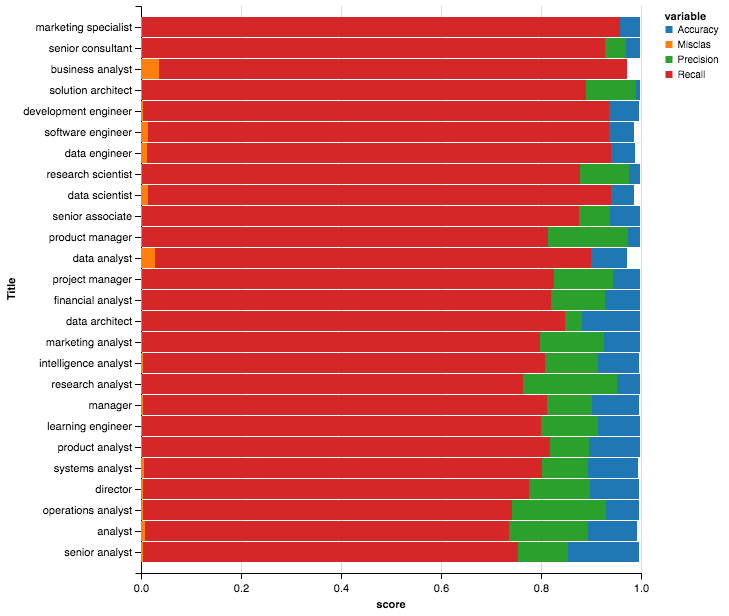

In [170]:
# melt for altair
forchart  = pd.melt(conf_mtx_df,id_vars =['Title'],value_vars=['Accuracy','Precision','Recall','Misclas'],value_name='score')
Chart(forchart).mark_bar().encode(
    x=X_axis(field='score'),
    y=Y_axis(field='Title', sort=SortField('score',order='descending',op='sum')),
    color = 'variable',
)

Looking at an updated version of similarity chart. Large circles means that there is a high similarity between the two titles. Dark circles means tht this occurs very often. Note that the largest circle is maximum 0.6 probability.  

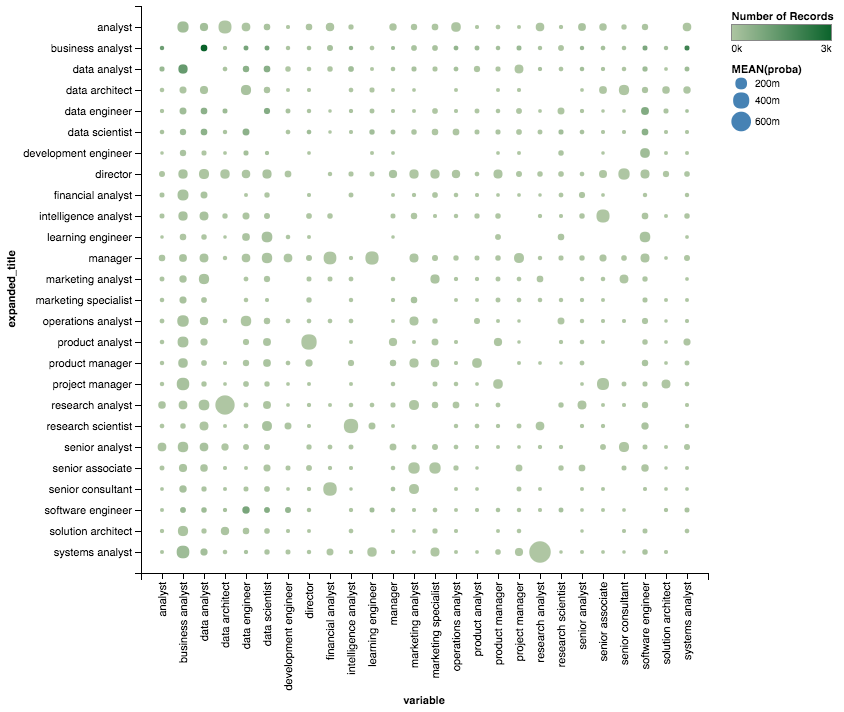

In [128]:
c = plotTitleToTitle(predicted_l1)
c

Looking at an updated version of vocab to feature count. These are the top 50 words by overall occurance. Larger circles mean that there is a higher occurance on average. So large circle on "product" means that the word shows up a large number of times on average  for Product manager. A dark circle means that there are a large number of these postings

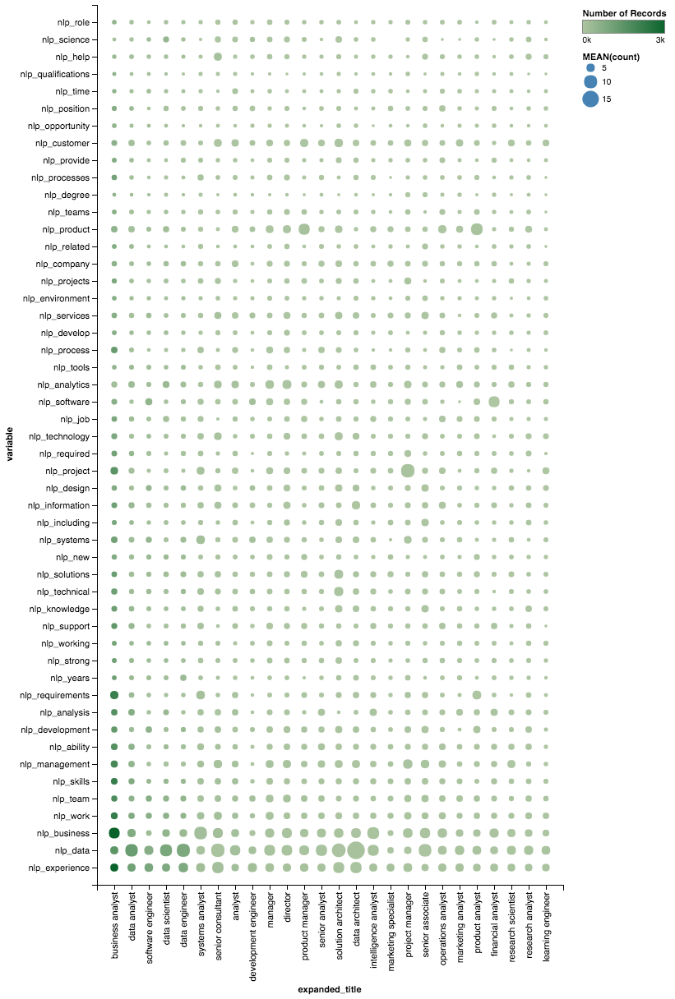

In [129]:
d = plotTitleToWords(predicted_l1)
d

<a id='section17'></a> <a href='#home'>Back to Table of Contents</a>
##  17 Comparison of Betas 

After re-running the model with regularization to reduce the overfitting, the betas will be compared between the regular and the regularized versions of the model to see how the results have been adjusted. The coefficients are taken from the two different fit One vs. Rest Models, and then these words will be plotted for the following classes:

- Data scientist
- Data Analyst
- Data Engineer
- research Scientist

In [130]:
# these shoudl have already been run

fitfeat_dict = topFeatMulti(OVRC, mlb.classes_, X.columns)
fitfeat_dict_l1 = topFeatMulti(OVRC_l1, mlb.classes_, X.columns)

analyst
(0.70597930346755833, u'nlp_analyses')
(0.63412968758011945, u'nlp_chicago')
(-0.62011464586768439, u'nlp_seeking')
(-0.61157001463464755, u'nlp_looking')
(0.54213867983993702, u'nlp_uw')
(0.54069850513357121, u'nlp_spend')
(0.53853201461367262, u'nlp_metadata')
(0.53507889090858929, u'nlp_pay')
(0.52123578988825559, u'nlp_proficiency')
(0.51880535354757495, u'nlp_offshore')
business analyst
(-1.1287981746254698, u'nlp_machine')
(0.67961847456410951, u'nlp_ba')
(-0.66103738591201222, u'nlp_python')
(-0.64124722827264791, u'nlp_entry')
(-0.6150424574399922, u'nlp_quarterly')
(0.61492730126934247, u'nlp_departments')
(0.60732258097958258, u'nlp_lines')
(-0.59206223871766639, u'nlp_spark')
(-0.58728615464408596, u'nlp_java')
(0.58225180537738341, u'nlp_gather')
data analyst
(0.64261717482985681, u'nlp_hardware')
(0.62950770162619218, u'nlp_looker')
(-0.62516030840982806, u'nlp_build')
(-0.62381806616055535, u'nlp_aws')
(-0.61392018300386175, u'nlp_phd')
(0.60012681797005019, u'nlp

In [131]:
def plot_beta_compare(class_string):
    smp = pd.DataFrame(fitfeat_dict[class_string])
    smp['data_set'] = 'nonreg_log'
    smp2 =  pd.DataFrame(fitfeat_dict_l1[class_string])
    smp2['data_set'] = 'regl1_log'
    for_chart = pd.concat([smp,smp2])
    for_chart.columns = ['beta','word','data_set']
    c = Chart(for_chart).mark_bar().encode(
        y = Y_axis('word',sort=SortField('beta',order='descending')),
        x = 'beta:Q',
        color = 'data_set'    
    )
    return c

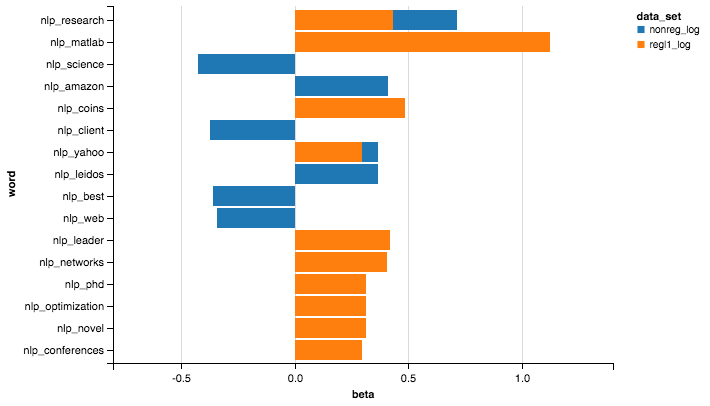

In [132]:
c = plot_beta_compare('research scientist')
c

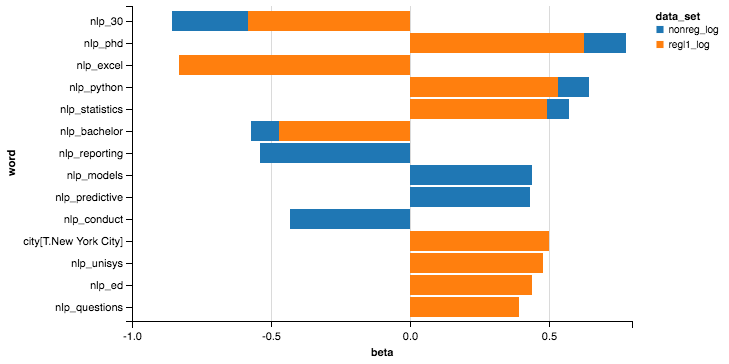

In [133]:
c = plot_beta_compare('data scientist')
c

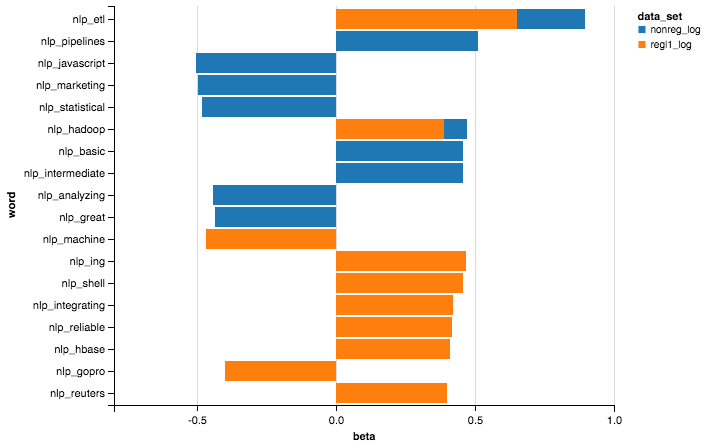

In [134]:
c = plot_beta_compare('data engineer')
c

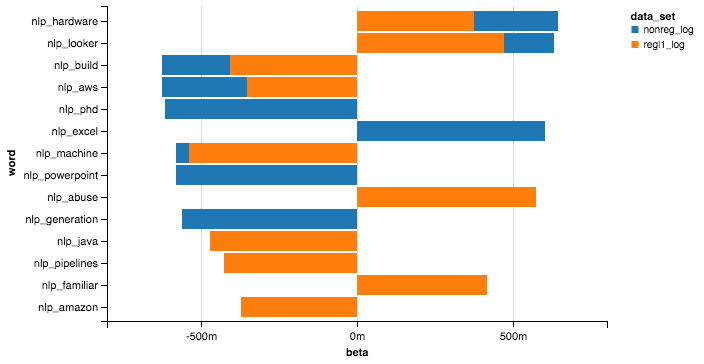

In [135]:
c = plot_beta_compare('data analyst')
c

<a id='section18'></a> <a href='#home'>Back to Table of Contents</a>
##  18. Conclusions and Takeaways

### Modeling 

- **Data science is still an ambiguous field** the two main avenues that this is being worked into is from the software/data engineering end and from the analytics business oriented end. One end is seeking to build the next level of intelligence and automation, and the other end is trying to understand the sea of data that is being generated daily. As a results, these responsibilities will creep into existing roles until new fully defined rolls can be established. This can be seen in the 60% predictive rate. These dedicated and specific positions are forming, but there is still a lot of ambiguity and cross over that exists as companies figure this out.

- **There is no bad score** - What I love about this problem is that there is no right answer. If the predicition score was incredibly low, than job titles mean nothing, and all job descriptions are not correlated. If The prediction score was 100% that would mean that we only have to apply to data scientists / data analysts and take solace that no other jobs slip through our fingers. At ~60%, that would mean that as you apply by title to various jobs, there's about 40% of other opportunities out there that are miss named, or that you couldn't find because it was named incorrectly.  

- **Prediction could be better, but uncertain how much** With a rough score of 0.5-0.6 on the prediction, its a good sign that more detail could be mined out from the job postings. Ensemble methods were avoided because the goal was to understand the inner workings, not to achieve the highest prediction score. 

- **Additional Models** - Further work into decision tree classifiers may yield more insights. But I believe further feature engineering with the actual text would yield the most benefit.

- **Multiclass adds n-processing time** with grid search, cross val score, regularization, there's already a lot of iterations to complete, and having a multiclass only adds to the processing requirements of this project.


### Webscraping:

- **Anythign can be webscraped if you have patience:** if you are willing to pull data 1-2 records a minute. At that rate, how good of a competitor/ pirate could you be?

- **HTML is messy business:** Many top companies' HTML are full of all sorts of junk, either on purpose or accident, their pages are a mess. Be prepared to dig for tags 

- **Internet HTML Formatting is the wildwest:** Each company is built differently. Pulling from company websites would be ideal, but would take significant time to design an extraction template from each one. This why 

- **With big data, comes big duplication:** There's a lot of dups out there and because of the data size, and there's no where to dedup. I started out with 50k job postings that shrunk to 18k, because of repostings or duplication across multiple job sites


### NLP for Job Postings

- **Jobs are abstract items, inherently difficult ** - Jobs in general are difficult to define at times. If there isn't a specific purpose or skill that is required such as "blacksmith" or "must know piping", many jobs sound the same at the high level, talking to people, setting up meetings ,and getting a wide variety taskes complete. It's not always easy to summarize a job, much less translate your current experience into a different position. Being very organized with monthly team meetings, and designing websites sometimes gets abstracted to : people-person, go-getter, not afraid to be technical.

- **Garbage in, Garbage Out** - and unfortunately for job postings, there's a lot of unnecessary words. There's phrases that are added for legal or generic requirementslike "be a strong communicator", or "be a hard worker", but is a lot of noise compared to the rest of the data  

- **Removing disclaimers** - every company always has a "fluff" piece near the beginning of the posting and a disclaimer near the bottom, disclaiming anything about race, gender, and equal opportunity, its difficult to isolate these common words to isolate the target

- **Responsiblities / Requirements / Must Haves / What you'll do/ What you'd need** This section is often the key area to scrutinize to determine the minimum requirements for applying. Unfortunately every hip-recruiter or company has decided to rename this section to something else. Sometimes jobs will have "must haves" and "nice to have" or sometimes its built into each line.

### Next Steps:

- **Problem is now setup for Topic Modeling** - since it is shown that there is about a 40% ambiguity rating in the overall data science market from looking at pure words, it's the perfect time to move to advanced NLP or topic modeling. The topic modeling will extract more of the latent detail and provide a psuedo-metric to measure on. Instead of "how many times does data & science appear", the question will be "how close to Business-reporting topic does this job posting land?" "how close is it to statistical-data-prediction topic?" I've prototyped this process, but this in itself is a whole other capstone



<a id='appendix'></a> <a href='#home'>Back to Table of Contents</a>
# Appendix - AWS code
** AWS Python Source Code **


```
#load the data
import datetime
import pandas as pd
import cPickle as pickle
import patsy
import unidecode
import numpy as np
from altair import *

from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.multiclass import OneVsRestClassifier

from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_extraction.text import CountVectorizer

global_start = datetime.datetime.now()
local_start = datetime.datetime.now()

def printProgress(messages):
	global global_start
	global local_start
	current = datetime.datetime.now()
	print 'task time: ', current-local_start, 'overall', current-global_start
	print '='*100
	print messages
	local_start = current

def uncode(x):
    try:
        return unidecode.unidecode(x.decode('utf-8')).replace('\n',' -').lower()

    except:
        try:
            return unidecode.unidecode(x).replace('\n',' -').lower()
        except:
            print x
            return x 

def load_master():
	with open('../jNotebooks/master_total_df.p','rb') as f:
		master_total_df = pickle.load(f)
	return master_total_df

def munge(master_total_df):
	master_total_df.city = master_total_df.city.map(lambda x :'other' if type(x) == dict else x)
	master_total_df.city.fillna('other', inplace=True)
	master_total_df.state.fillna('other', inplace=True)
	master_total_df.company.fillna('other',inplace=True)
	master_total_df.company = master_total_df.company.map(uncode)
	return master_total_df

def truncateTopTitles(master_total_df):
	alltitles = master_total_df.expanded_title.value_counts()
	limittitles = alltitles[alltitles>100].index

	limited_postings = master_total_df.loc[master_total_df['expanded_title'].isin(limittitles)].copy()
	limited_postings.reset_index(inplace=True)
	
	def removeTitles(y):
	    y = y.lower()
	    for z in limittitles:
	        y = y.replace(z,' ')
	    return y
	limited_postings['orig_jobdesc'] = limited_postings['jobdesc']
	limited_postings['jobdesc'] = limited_postings['jobdesc'].map(removeTitles)
	limited_postings['jobdesc'] = limited_postings['jobdesc'].map(lambda x : x.replace('\n',' '))
	limited_postings['desc_len'] = limited_postings['jobdesc'].map(lambda x: len(x))

	limited_postings['cleandesc'] = limited_postings['jobdesc'].map(uncode) 
	
	limited_postings = limited_postings[['expanded_title','base_title','company','city','state','jobdesc','desc_len','cleandesc','orig_jobdesc']]
	return limited_postings



def addStatFields(limited_postings):
	
	dsi_terms = ['machine learning'
	             ,'data science'
	             ,'model'
	             ,'predict'
	             ,'regression'
	             ,'bayes'
	             ,'sklearn'
	             ,'data scientist'
	             ,'neural network'
	             , ' R '
	             ,'SQL'
	            ]
	for y in dsi_terms:
	    limited_postings['term_'+y.strip()] = limited_postings['cleandesc'].map(lambda x : len(x.split(y))-1)

	    
	limited_postings['totalterms'] = sum([limited_postings[x] for x in limited_postings.columns if 'term_' in x])
	limited_postings['totalterms'] = limited_postings['totalterms'].astype(float)

	company_posting_summary = limited_postings.company.value_counts()
	top_co_post = company_posting_summary[:25]
	
	company_term_summary = limited_postings.groupby('company')[['totalterms']].sum().reset_index().sort_values('totalterms', ascending=False)
	top_co_terms = company_term_summary[:25]

	limited_postings['term_company'] = limited_postings['company'].map(lambda x: x if x in top_co_terms['company'].values else 'other_co')
	limited_postings['post_company'] = limited_postings['company'].map(lambda x: x if x in top_co_post else 'other_co')

	return limited_postings

import pandas as pd
import numpy as np
import datetime
import cPickle as pickle
import unidecode


# takes in list of text fields, manipulates them

class hardSkillParser(object):


    def __init__(self,list_of_text):
        #expecting a single value data frame
        self.text_dict = [{'text':self._fixText(x)} for x in list_of_text] 
        
    def load(self,list_of_text):
        self.text_dict = [{'text':self._fixText(x)} for x in list_of_text]
        
#===========================================================================        

    # some of hte HTML data that was pulled needs to be 
    # decoded from unicode and either falls in one of the
    # two combinations: decode UTF8 then UNICODE decode
    
    def _fixText(self, input_string):
        prevlower = False
        newText = ''
        for x in input_string:
            if x=='*':
                newText +='\n'
            elif x.isalpha()==False:
                prevlower=0
            elif x.islower():
                prevlower = True

            if (prevlower == True) & (x.isupper()):
                newText += '.\n' + x
                prevlower = False        
            else:
                newText += x
        return newText
            
            
    # similar to the previous function but 
    # designed for pandas MAP and APPLY functions
    
    def _cleanLI(self, yy):
        newlist = []
        for y in yy:
            try:
                newlist.append(unidecode.unidecode(y.decode('utf-8')).lower())
            except:
                try:
                    newlist.append(y.decode('utf-8').lower())
                except:
                    newlist.append(y.lower())
        return newlist       
   
    
    # =========================================================
    # pulls newline delinated lines, since these are typically
    # the bullet point descriptions
    # and have a higher percentage of relevant details
    # relating to job instead of disclaimers, or 
    # company background or descriptions
    
    def _parseLI(self,y):
        LI = []
        y  = y.replace('i.e.','-ie-').replace('e.g.','-eg-')
        for x in y.split('\n'):
            ct = len(x.strip().split('.'))
            if ct ==1:
                if len(x)>0:
                    LI.append(x)
            elif len(x.strip().split('.')[1])<=1:
                if len(x.strip().split('.')[0])>0:
                    LI.append(x.strip().split('.')[0])
        return LI

    # =========================================================    
    # this will provide a second level of detail
    # from the LI items pulled, this will go through and further
    # pull out more hard topics
    
    def _splitLI(self,y,phrase):
        try:
            if phrase in ('to','in'):
                return y.split(' '+phrase+' ')[1]
            else:
                return y.split(phrase)[1]
        except:
            return ''

#===========================================================================        

     
    def fit(self):
        start = datetime.datetime.now()
        terms = ['in','including','knowledge of','experience with', 'understanding of', 'to','develop ','design ','requirements']
        for x in self.text_dict:
            x['LI'] =self._cleanLI(self._parseLI(x['text']))
            hardskill = []
            for y in terms:
                x[y] = [self._splitLI(LI,y) for LI in x['LI']]
                x[y] = [z for z in x[y] if z!='']
                hardskill.extend(x[y])
            x['hardskill'] = hardskill
            x['LI_text'] = ' '.join(x['LI'])
            x['hardskill_text'] = ' '.join(x['hardskill'])
        print datetime.datetime.now()-start
        
        self.parsed_df = pd.DataFrame(self.text_dict)[['text','LI','LI_text','hardskill','hardskill_text']]
    
    def save(self,prefix='_'):
        suffix = str(int(time.mktime(datetime.datetime.now().timetuple())))[-6:]
        with open("008_"+prefix+"_parsed_text_dict_"+suffix+".p",'wb') as f:
            pickle.dump(self.text_dict,f)
        with open("008_"+prefix+"_parsed_df_"+suffix+".p",'wb') as f:
            pickle.dump(self.parsed_df,f)


def NLP_parser(text):
    # using count vectorizer to turn the cleaned job descriptions into feadutes
    cvec = CountVectorizer(stop_words='english', lowercase=True,ngram_range=(1,1))
    start_time = datetime.datetime.now()
    cvec.fit(text)


    cdf  = pd.DataFrame(cvec.transform(text).todense(),
                 columns=cvec.get_feature_names())

    #keeping the top 20,000 features (or words)
    summary = cdf.sum().sort_values(ascending = False)
    keep_cols = summary[:20000].index
    cdf_to_merge = cdf[keep_cols]


    # since some of the words are reserved, adding NLP_ as a prefix to stop any type of compiler issues
    cdf_to_merge.columns = ['nlp_'+x for x in cdf_to_merge.columns]
    return cdf_to_merge




def generateXY(base_dataframe, word_df):
    formula = 'expanded_title ~ company + city + state + desc_len -1'
    print formula
    y, X = patsy.dmatrices(formula, base_dataframe, return_type='dataframe')
    # will ignore the y value for the matrix below

    X = X.merge(word_df, how = 'left', left_index=True,right_index=True)
    print X.shape

    # turns y into a multi class matrix
    # 2 classes require a single vector n multiclassification requires n-1 matrix
    mlb = MultiLabelBinarizer()
    y = mlb.fit_transform([[x] for x in limited_postings['expanded_title']])
    print mlb.classes_
    print y.shape
    return y, X, mlb



def multiGres(model, X,y, gs='no',params=None, cv=5):
    
    #splitting data for cross validation
    
    X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2)
    print X_train.shape, X_test.shape, y_train.shape, y_test.shape

    start = datetime.datetime.now()
    if (params==None) or (gs=='no'):
        
        #non-grid search model
        #initialize the one vs. rest classifier, fit and score
        
        print 'initialzing One vs. Rest'
        OVRC = OneVsRestClassifier(model,n_jobs=-1)
        print 'Fitting training data...'
        OVRC.fit(X_train,y_train)
        print datetime.datetime.now()-start
        print 'scoring....'
        train_score = OVRC.score(X_train,y_train)
        test_score = OVRC.score(X_test,y_test)
        print 'train score'
        print train_score
        print 'test score'
        print test_score
        return train_score, test_score, OVRC
    else:
        print 'finish making function'


def topFeatMulti(OVRC, bin_class_list, X_columns):
    coefs = []
    for x in OVRC.estimators_:
        coefs.append(x.coef_) 
    fitfeat_dict = {}
    for x,y in zip(bin_class_list, coefs):
        coef_lkup = {abs(m):(m,n) for m,n in zip(y[0],X_columns)}
        top5 = np.sort(abs(y))[0][::-1][:10]
        top5_labeld = [coef_lkup[m] for m in top5]
        print '='*60
        print x
        for m in top5_labeld:
            print m
        fitfeat_dict[x] = top5_labeld
    
    return fitfeat_dict


def topGuesses(OVRC, X, original, mlb):
    proba = OVRC.predict_proba(X)
    print proba.shape
    df = pd.DataFrame(proba)
    df.columns = mlb.classes_
    def topPredict(y):
        top3 = y.transpose().sort_values(ascending=False)[:4]
        return [(x,z) for x,z in zip(top3.index, top3)]

    df['top_pred'] = df.apply(topPredict,axis=1)
    results = original.merge(df[['top_pred']], how='left', left_index=True, right_index=True)
    results['yhat'] = results['top_pred'].map(lambda x: x[0][0]) 
    return results






#==============================================================================================================
#==============================================================================================================
#==============================================================================================================


# initialize the storage dictionary
results_storage = {}




def preprocess():
	printProgress('loading data')
	master_total_df = load_master()

	printProgress('subsetting by expanded titles that have > 100 occr')	
	limited_postings = truncateTopTitles(munge(master_total_df))

	printProgress('adding EDA ML stat fields')
	limited_postings = addStatFields(limited_postings)

	printProgress('creating subtexts')
	hSP = hardSkillParser(limited_postings['orig_jobdesc'])
	hSP.fit()
	fulltext = limited_postings['cleandesc']
	LItext = hSP.parsed_df['LI_text']
	HStext = hSP.parsed_df['hardskill_text']
	full_df = NLP_parser(fulltext)
	LI_df = NLP_parser(LItext)
	HS_df = NLP_parser(HStext)
	print full_df.shape, LI_df.shape, HS_df.shape
	return limited_postings, full_df, LI_df, HS_df


limited_postings, full_df, LI_df, HS_df = preprocess()

# =============================================================
printProgress('Generating X and y for full text')
y, X, mlb = generateXY(limited_postings, full_df)


printProgress('start modeling - starting with full text')
printProgress('Logistic Regression - vanilla')
lgr = LogisticRegression(n_jobs=-1, max_iter=5000)
train_score, test_score, OVRC = multiGres(lgr, X, y)

fitfeat_dict = topFeatMulti(OVRC, mlb.classes_, X.columns)
predicted = topGuesses(OVRC, X, limited_postings,mlb)


# saving results
results_storage['FULL_LOG'] = {
	'train_score' : train_score
	, 'test_score' : test_score
	, 'fitfeature_dict':fitfeat_dict
	, 'predicted': predicted['top_pred']
}



for C in [.01,.1,1.,10,100]:
	printProgress('Logistic Regression - with l1 loss %f' % C)
	lgr = LogisticRegression(n_jobs=-1, penalty='l1',max_iter = 5000, C=C)
	train_score, test_score , OVRC = multiGres(lgr, X, y)
	
	fitfeat_dict = topFeatMulti(OVRC, mlb.classes_, X.columns)
	predicted = topGuesses(OVRC, X, limited_postings,mlb)

	#Saving results
	results_storage['FULL_LOGL1'+str(C)] = {
		'train_score' : train_score
		, 'test_score' : test_score
		, 'fitfeature_dict':fitfeat_dict
		, 'predicted': predicted['top_pred']
	}


X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2)
print X_train.shape, X_test.shape, y_train.shape, y_test.shape
printProgress('Random Forest Classifier')
rfc = RandomForestClassifier(n_estimators=1000, n_jobs = -1)
rfc.fit(X_train, y_train)
train_score = rfc.score(X_train, y_train)
test_score = rfc.score(X_test, y_test)
print train_score, test_score

results_storage['FULL_RFC'] = {
	'train_score' : train_score
	, 'test_score' : test_score
	, 'fitfeature_dict': None
	, 'predicted': None
}


# =============================================================
printProgress('Generating X and y for line item text')
y, X, mlb = generateXY(limited_postings, LI_df)


printProgress('start modeling - starting with full text')
printProgress('Logistic Regression - vanilla')
lgr = LogisticRegression(n_jobs=-1, max_iter=5000)
train_score, test_score , OVRC = multiGres(lgr, X, y)


fitfeat_dict = topFeatMulti(OVRC, mlb.classes_, X.columns)
predicted = topGuesses(OVRC, X, limited_postings,mlb)


# saving results
results_storage['LI_LOG'] = {
	'train_score' : train_score
	, 'test_score' : test_score
	, 'fitfeature_dict':fitfeat_dict
	, 'predicted': predicted['top_pred']
}


for C in [.01,.1,1.,10,100]:
	printProgress('Logistic Regression - with l1 loss %f' % C)
	lgr = LogisticRegression(n_jobs=-1, penalty='l1',max_iter = 5000, C=C)
	train_score, test_score , OVRC = multiGres(lgr, X, y)

	fitfeat_dict = topFeatMulti(OVRC, mlb.classes_, X.columns)
	predicted = topGuesses(OVRC, X, limited_postings,mlb)

	#Saving results
	results_storage['LI_LOGL1'+str(C)] = {
		'train_score' : train_score
		, 'test_score' : test_score
		, 'fitfeature_dict':fitfeat_dict
		, 'predicted': predicted['top_pred']
	}

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2)
print X_train.shape, X_test.shape, y_train.shape, y_test.shape
printProgress('Random Forest Classifier')
rfc = RandomForestClassifier(n_estimators=1000, n_jobs = -1)
rfc.fit(X_train, y_train)
train_score = rfc.score(X_train, y_train)
test_score = rfc.score(X_test, y_test)
print train_score, test_score

results_storage['LI_RFC'] = {
	'train_score' : train_score
	, 'test_score' : test_score
	, 'fitfeature_dict': None
	, 'predicted': None
}




# =============================================================
printProgress('Generating X and y for HS text')
y, X, mlb = generateXY(limited_postings, HS_df)


printProgress('start modeling - starting with full text')
printProgress('Logistic Regression - vanilla')
lgr = LogisticRegression(n_jobs=-1, max_iter=5000)
train_score, test_score , OVRC = multiGres(lgr, X, y)


fitfeat_dict = topFeatMulti(OVRC, mlb.classes_, X.columns)
predicted = topGuesses(OVRC, X, limited_postings,mlb)

# saving results
results_storage['HS_LOG'] = {
	'train_score' : train_score
	, 'test_score' : test_score
	, 'fitfeature_dict':fitfeat_dict
	, 'predicted': predicted['top_pred']
}

for C in [.01,.1,1.,10,100]:
	printProgress('Logistic Regression - with l1 loss %f' % C)
	lgr = LogisticRegression(n_jobs=-1, penalty='l1',max_iter = 5000, C=C)
	train_score, test_score , OVRC = multiGres(lgr, X, y)


	#Saving results
	results_storage['HS_LOGL1'+str(C)] = {
		'train_score' : train_score
		, 'test_score' : test_score
		, 'fitfeature_dict':fitfeat_dict
		, 'predicted': predicted['top_pred']
	}

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2)
print X_train.shape, X_test.shape, y_train.shape, y_test.shape
printProgress('Random Forest Classifier')
rfc = RandomForestClassifier(n_estimators=1000, n_jobs = -1)
rfc.fit(X_train, y_train)
train_score = rfc.score(X_train, y_train)
test_score = rfc.score(X_test, y_test)
print train_score, test_score

results_storage['HS_RFC'] = {
	'train_score' : train_score
	, 'test_score' : test_score
	, 'fitfeature_dict': None
	, 'predicted': None
}



print 'saving stored results'
with open('../datastorage/MULTILOG_RESULTS.p','wb') as f:
	pickle.dump(results_storage, f)








```



 <a href='#home'>Back to Table of Contents</a>